In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**GENERAL TASK**

**Goal** : To create a classifier that will classify the given hyperspectral data based on some features

Methodology :

1. First I loaded and checked how the data looked. The given data is in .fits format. When i downloaded , the given drive had 150 samples.

To handle this .fits file, I have used Astropy package (https://www.astropy.org/) .

2. A. After loading , I visualised the data, in the task brief , it was given that the first one , i.e index 0 is the only one that matters for this task.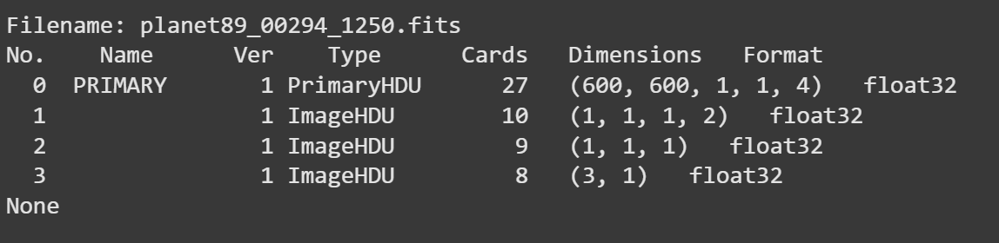





In [3]:
!pip3 install pytorch_msssim
!pip3 install astropy
!pip3 install hdbscan


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 55.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 32.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 16.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 75.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [4]:
# Attach the drive
from google.colab import drive
drive.mount('/content/drive')

# Necessary imports

import zipfile
import os
from astropy.io import fits
from scipy.stats import entropy, pearsonr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sb
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import pearsonr
from IPython.display import Image, display
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from pytorch_msssim import ms_ssim
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import hdbscan
import torch
import torch.nn as nn
import torch.nn.functional as F
import random
import umap.umap_ as umap
import warnings
from torchvision.models import alexnet
import matplotlib.pyplot as plt
from IPython.display import SVG, display
from tensorflow.keras.utils import plot_model
from pytorch_msssim import ms_ssim
from scipy.ndimage import gaussian_filter

warnings.filterwarnings("ignore")




Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
# Chk the directory
# os.chdir("/content/drive/MyDrive/Colab_Notebooks")
print(os.getcwd())

/content


In [6]:
# Its a zip file which has the samples, unzip it

"""
NOTE : replace the path with your system's / drive's
"""

file_src="/content/DATASET_EXXA.zip"

unzip_file_dest="/content/DATASET_EXXA"


with zipfile.ZipFile(file_src,"r") as filesr:

  filesr.extractall(unzip_file_dest)

# Change the directory
os.chdir("/content/DATASET_EXXA/")

# Take a random file and display its structure ( will be same as depicted above)
sample_file="planet9_00916_1250.fits"
hdu=fits.open(sample_file)
print(hdu.info())

Filename: planet9_00916_1250.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      27   (600, 600, 1, 1, 4)   float32   
  1                1 ImageHDU        10   (2, 1, 1, 2)   float32   
  2                1 ImageHDU         9   (2, 1, 1)   float32   
  3                1 ImageHDU         8   (3, 2)   float32   
None


In [7]:
# Store the necessary ones in a list
# Remove the singleton dimensions , our final dimensions of a sample will be (600,600,4)
pwd=os.getcwd()
primaryDataList = []

for file in sorted(os.listdir(pwd)):
    if file.endswith(".fits"):
        hdu = fits.open(os.path.join(pwd, file))
        data = hdu[0].data  # shape: (1, 1, 4, 600, 600)
        # print("data shape ",data.shape)
        hdu.close()

        image = np.squeeze(data)  # shape: (4, 600, 600)
        image = np.transpose(image, (1, 2, 0))  # shape: (600, 600, 4)
        # print(image.shape)

        primaryDataList.append(image)


In [8]:
# Check for any image corruptions like having nans or infs in between
for i in range(len(primaryDataList)):
  img=primaryDataList[i]
  if np.isnan(img).any() or np.isinf(img).any():
    print(f"####### Corruption at img no {i} ############################33")
  else:
    primaryDataList[i]=primaryDataList[i].astype(np.float32)
    print(f"img { i} clear!!!")

img 0 clear!!!
img 1 clear!!!
img 2 clear!!!
img 3 clear!!!
img 4 clear!!!
img 5 clear!!!
img 6 clear!!!
img 7 clear!!!
img 8 clear!!!
img 9 clear!!!
img 10 clear!!!
img 11 clear!!!
img 12 clear!!!
img 13 clear!!!
img 14 clear!!!
img 15 clear!!!
img 16 clear!!!
img 17 clear!!!
img 18 clear!!!
img 19 clear!!!
img 20 clear!!!
img 21 clear!!!
img 22 clear!!!
img 23 clear!!!
img 24 clear!!!
img 25 clear!!!
img 26 clear!!!
img 27 clear!!!
img 28 clear!!!
img 29 clear!!!
img 30 clear!!!
img 31 clear!!!
img 32 clear!!!
img 33 clear!!!
img 34 clear!!!
img 35 clear!!!
img 36 clear!!!
img 37 clear!!!
img 38 clear!!!
img 39 clear!!!
img 40 clear!!!
img 41 clear!!!
img 42 clear!!!
img 43 clear!!!
img 44 clear!!!
img 45 clear!!!
img 46 clear!!!
img 47 clear!!!
img 48 clear!!!
img 49 clear!!!
img 50 clear!!!
img 51 clear!!!
img 52 clear!!!
img 53 clear!!!
img 54 clear!!!
img 55 clear!!!
img 56 clear!!!
img 57 clear!!!
img 58 clear!!!
img 59 clear!!!
img 60 clear!!!
img 61 clear!!!
img 62 clear!!!
im

**2.B** : Data preprocessing and visualise the discs of all 4 channels

I experimented on different approached

a. ***Normalised*** the data accross all 4 channels, so its like image-max(image)/max-min.

b.*** Normalise every channel*** separately with its own channel max and mins

image[i]-max(image[i]) / max(image[i])-min(image[i])

where i is the channel index

c. ***Standardise*** across the channles to have 0 mean and SD 1

In [9]:
def normalise_img(image):

  imgMax=np.max(image)
  imgMin=np.min(image)

  if imgMax-imgMin>0:
    return (image-imgMin)/(imgMax-imgMin)
  else:
    return np.zeros_like(image)

def normalise_per_band(image):

  for band in range(image.shape[2]):
    band_max=np.max(image[:,:,band])
    band_min=np.min(image[:,:,band])
    if band_max-band_min>0:
      image[:,:,band]=(image[:,:,band]-band_min)/(band_max-band_min)
    else:
      image[:,:,band]=np.zeros_like(image[:,:,band])

  return image

def standardise_per_band(image):

  for band in range(image.shape[2]):
    band_mean=np.mean(image[:,:,band])
    band_std=np.std(image[:,:,band])
    if band_std>0:
      image[:,:,band]=(image[:,:,band]-band_mean)/band_std
    else:
      image[:,:,band]=np.zeros_like(image[:,:,band])

  return image


normalised=[]
normalised2=[]
standardised=[]

for image in primaryDataList:
  normalised.append(normalise_img(image))

for image in primaryDataList:
  normalised2.append(normalise_per_band(image))

for image in primaryDataList:
  standardised.append(standardise_per_band(image))



(600, 600, 4)


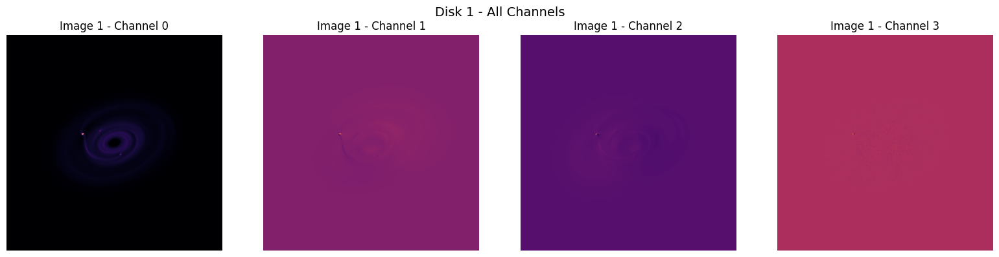

(600, 600, 4)


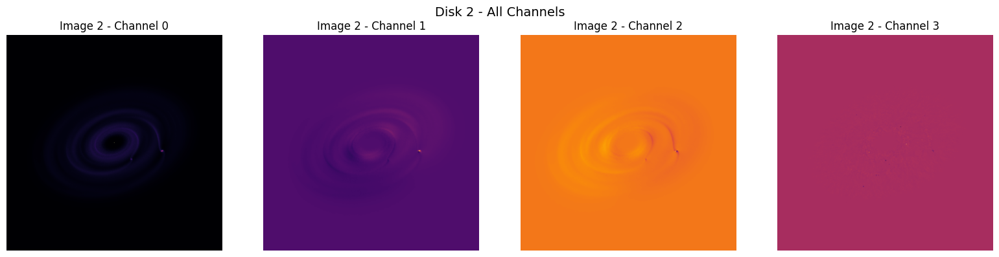

(600, 600, 4)


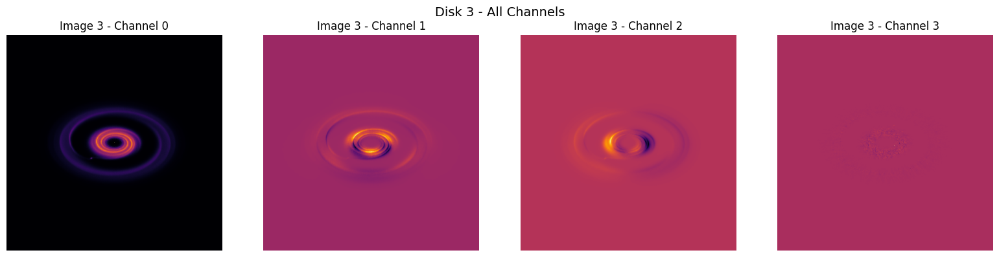

(600, 600, 4)


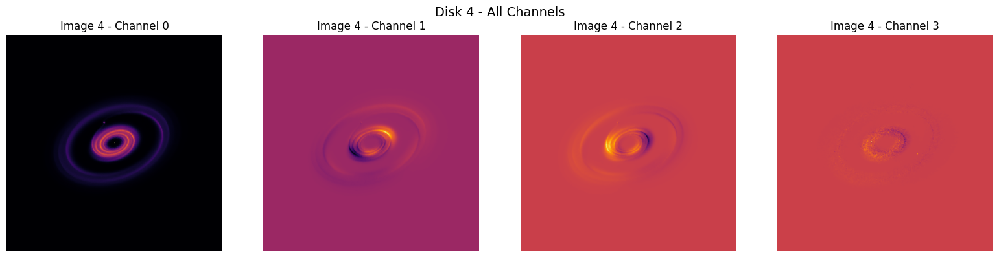

(600, 600, 4)


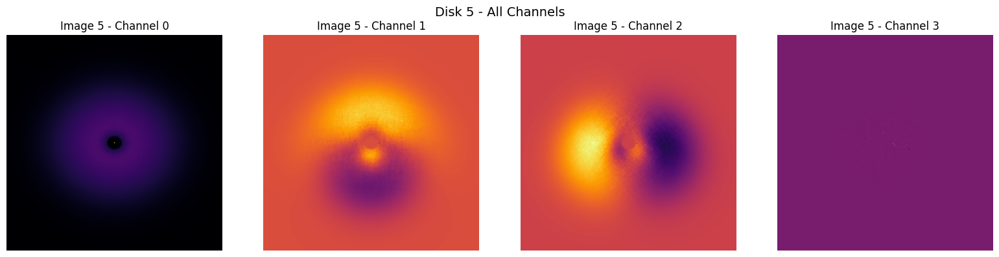

(600, 600, 4)


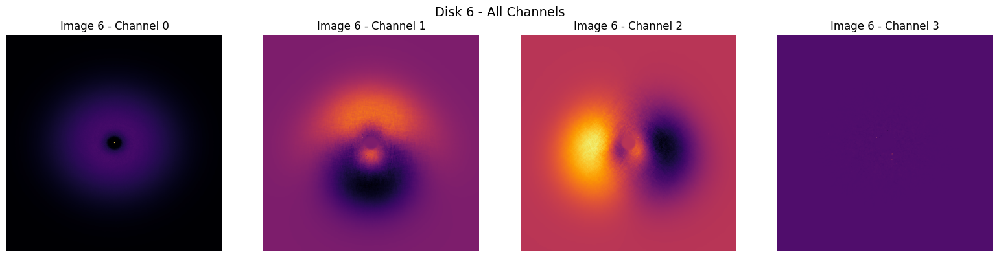

(600, 600, 4)


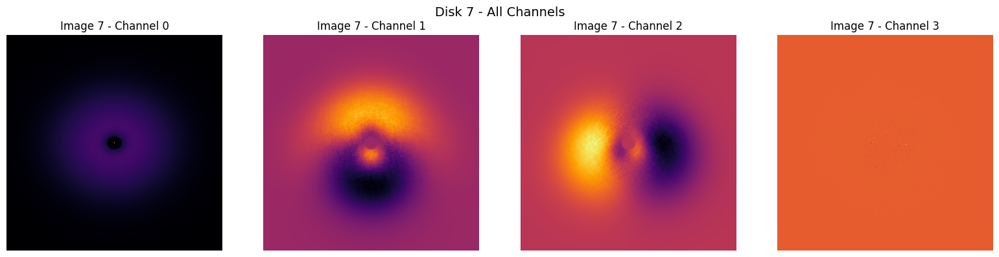

(600, 600, 4)


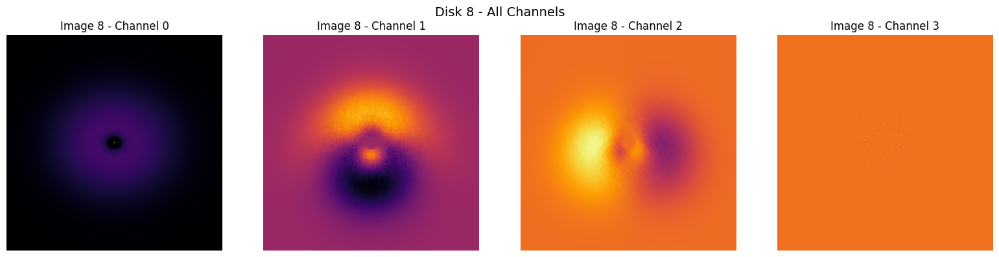

(600, 600, 4)


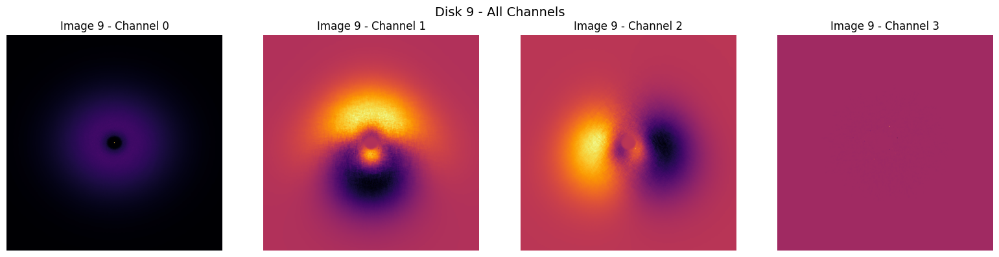

(600, 600, 4)


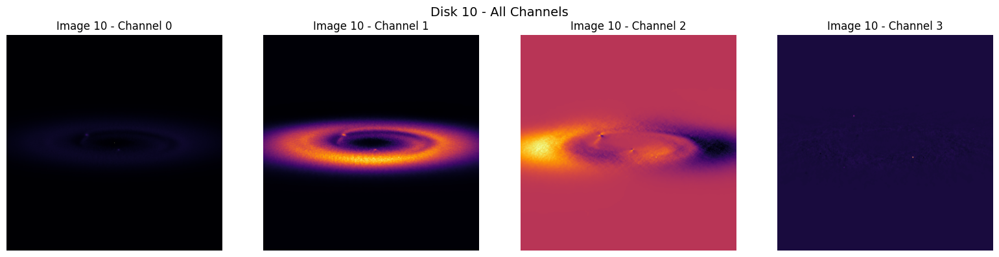

(600, 600, 4)


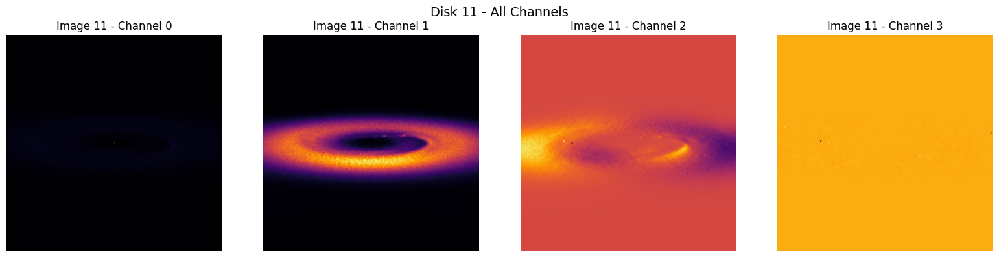

(600, 600, 4)


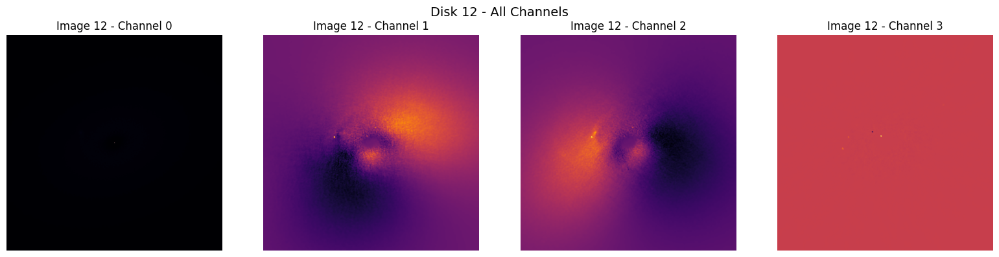

(600, 600, 4)


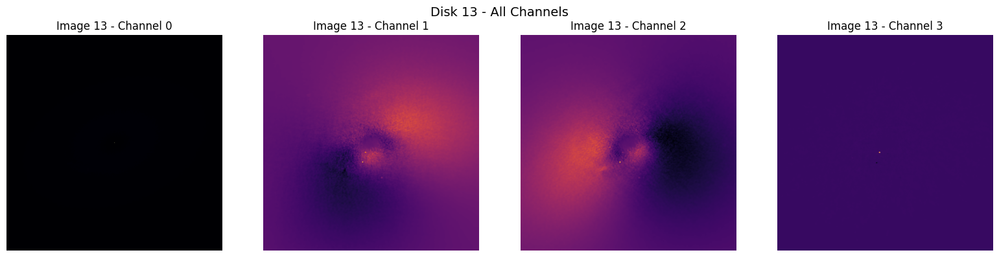

(600, 600, 4)


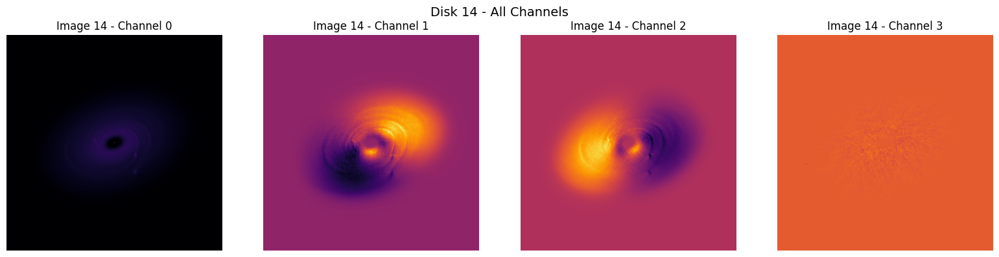

(600, 600, 4)


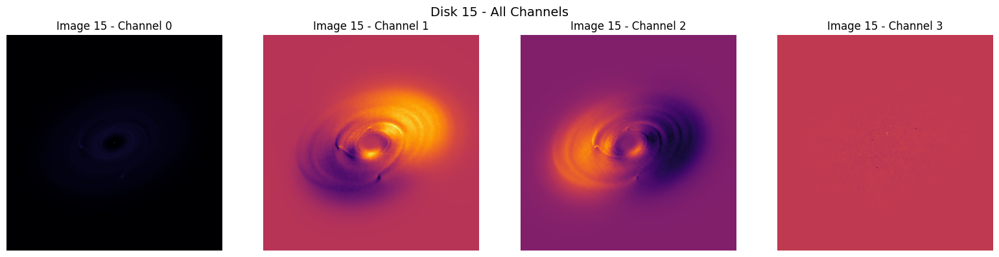

(600, 600, 4)


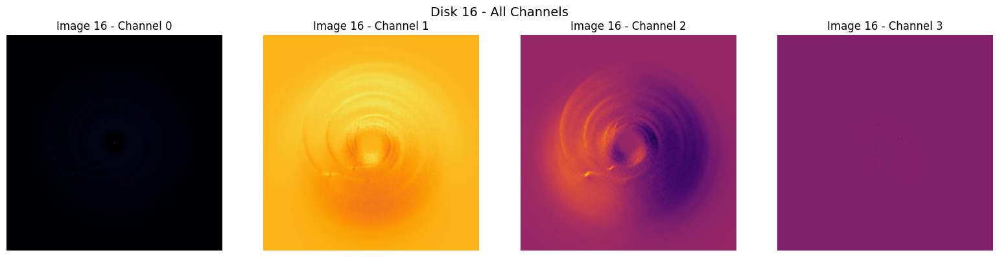

(600, 600, 4)


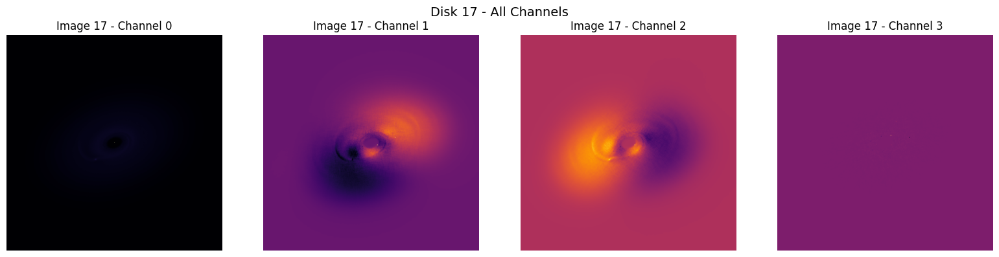

(600, 600, 4)


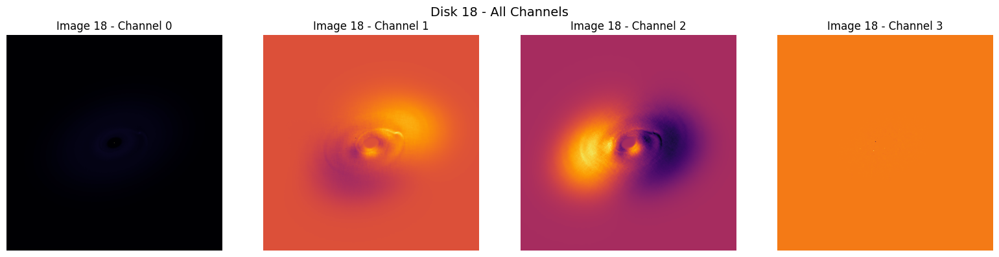

(600, 600, 4)


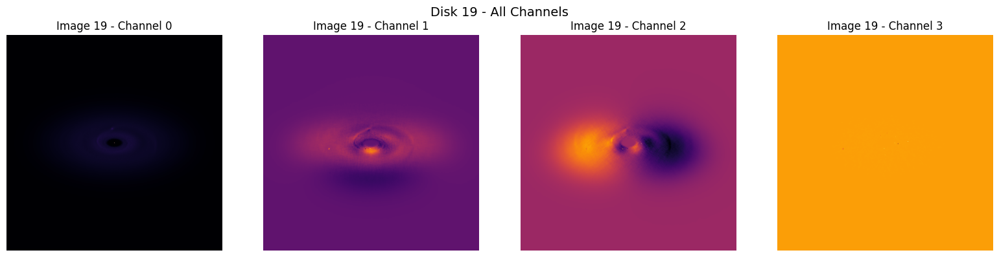

(600, 600, 4)


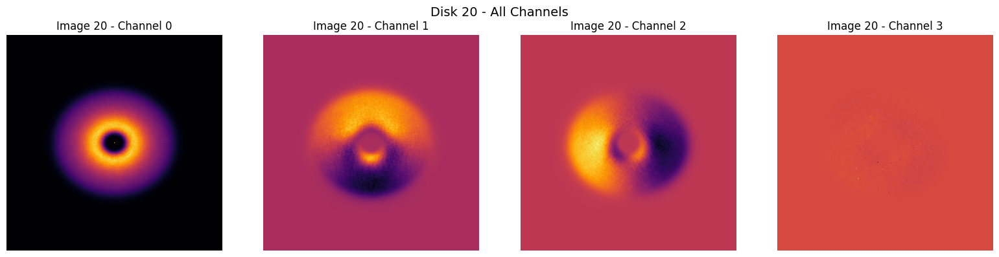

(600, 600, 4)


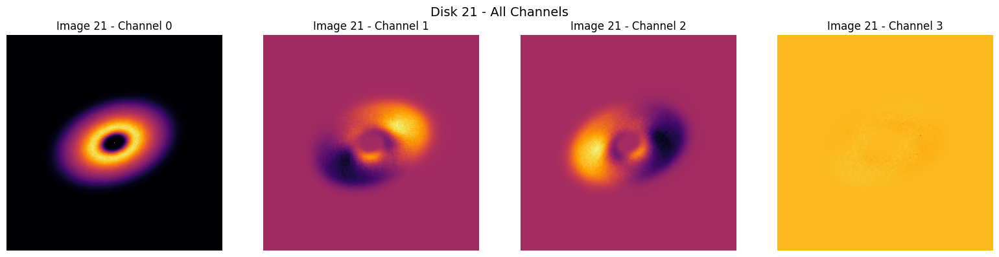

(600, 600, 4)


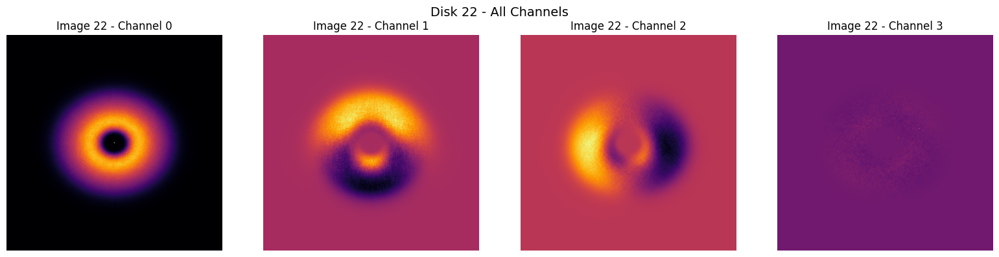

(600, 600, 4)


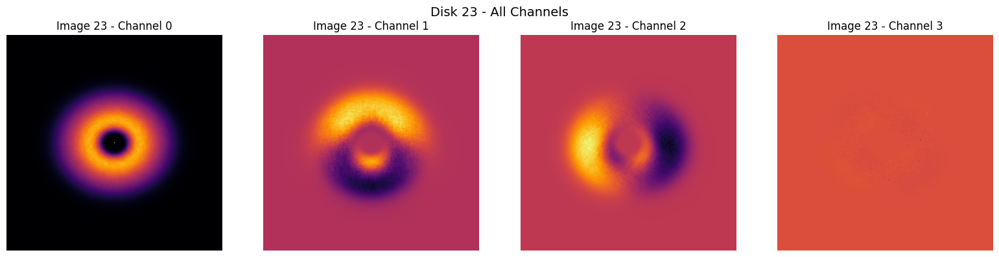

(600, 600, 4)


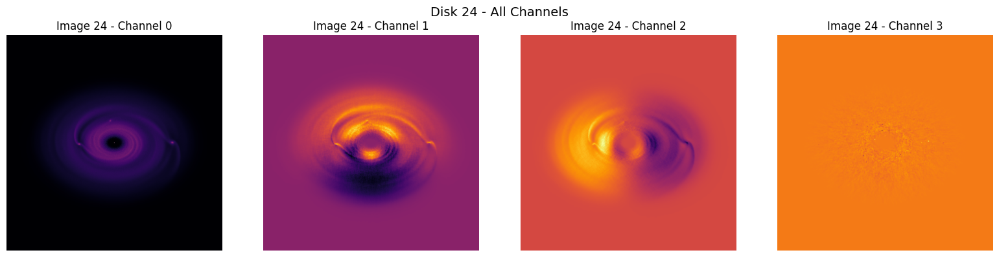

(600, 600, 4)


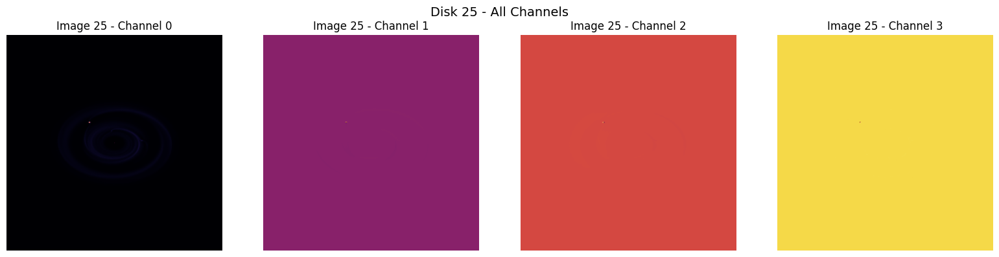

(600, 600, 4)


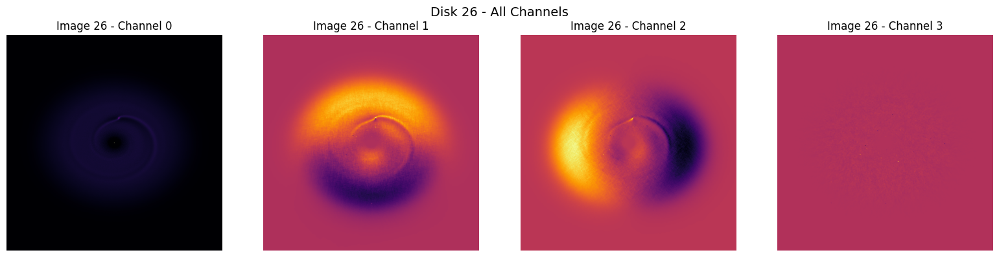

(600, 600, 4)


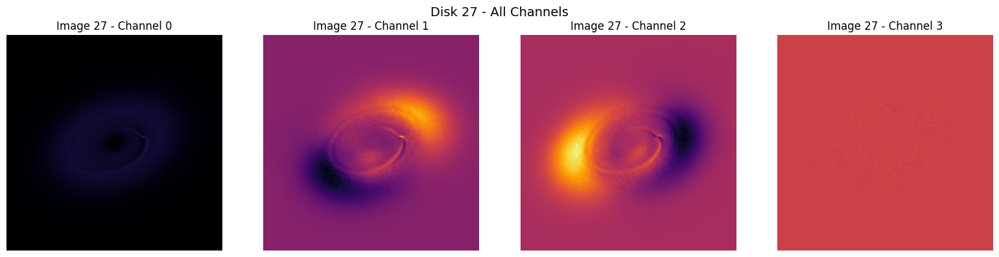

(600, 600, 4)


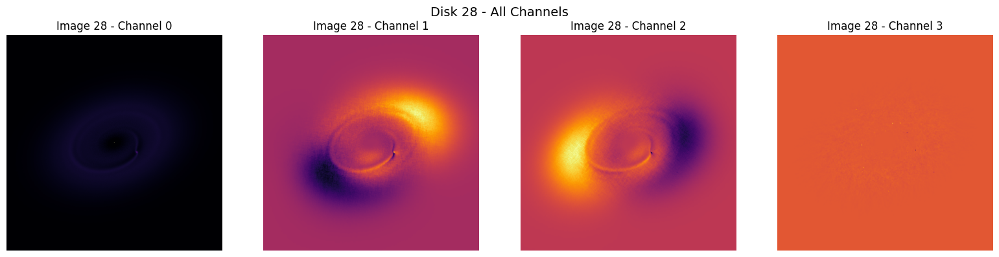

(600, 600, 4)


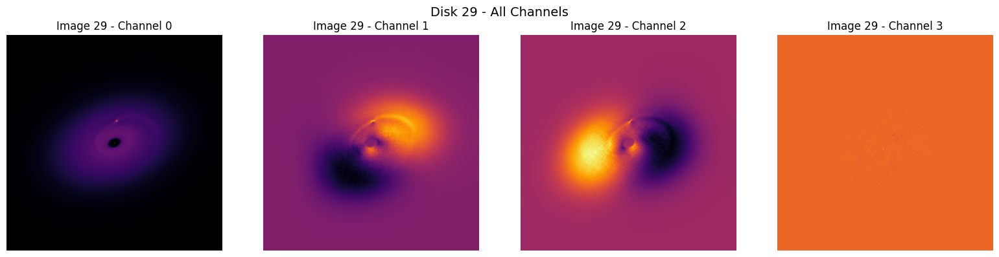

(600, 600, 4)


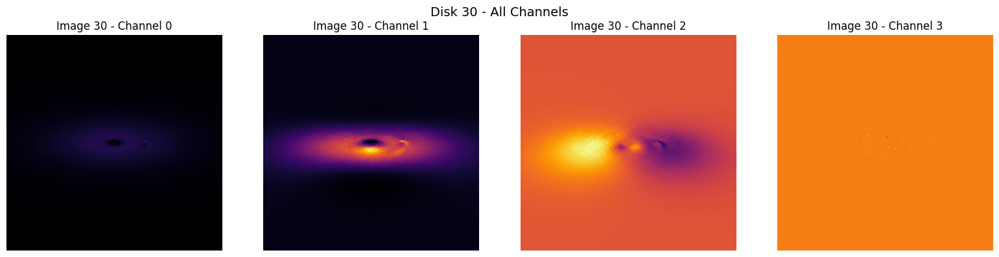

(600, 600, 4)


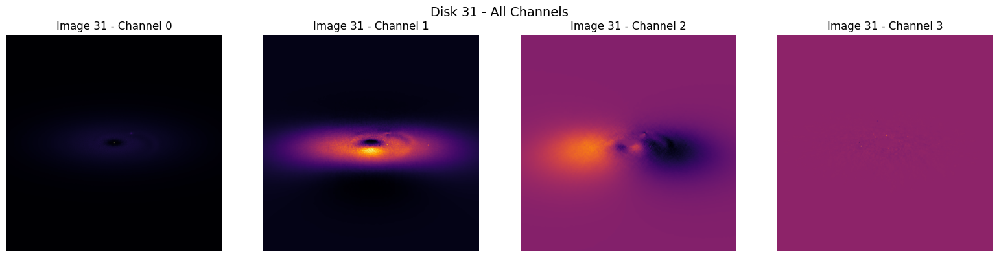

(600, 600, 4)


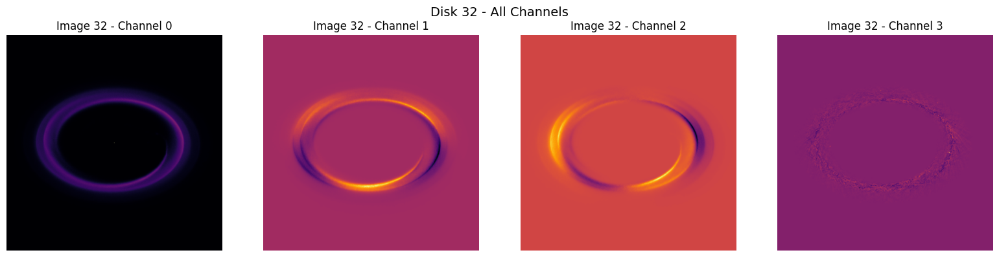

(600, 600, 4)


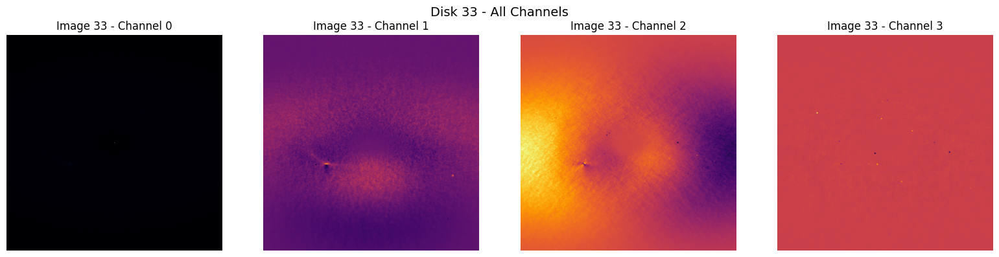

(600, 600, 4)


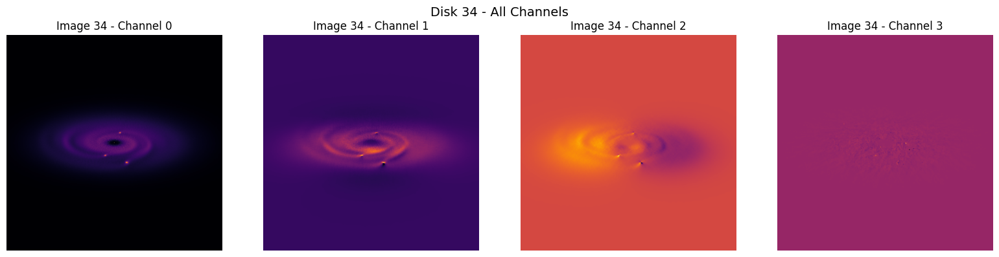

(600, 600, 4)


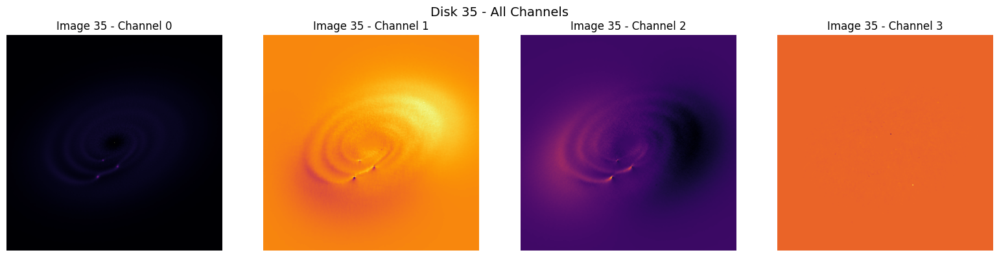

(600, 600, 4)


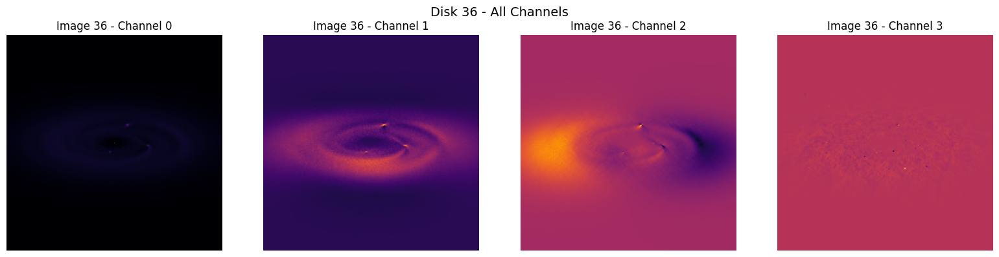

(600, 600, 4)


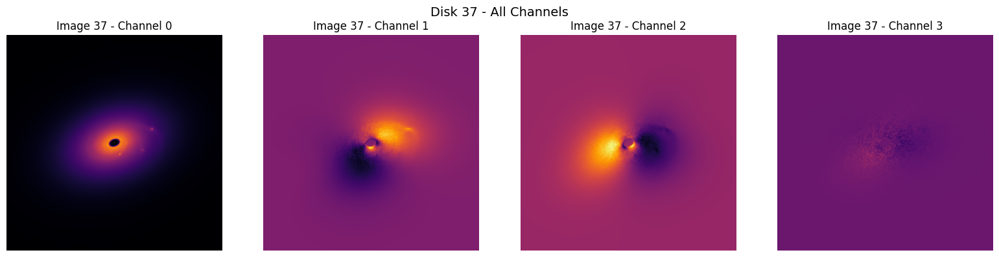

(600, 600, 4)


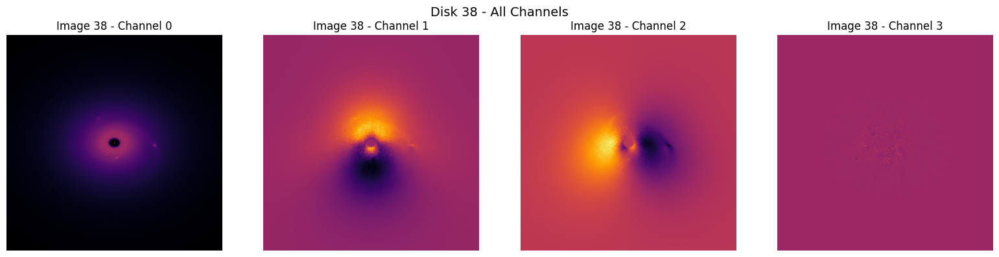

(600, 600, 4)


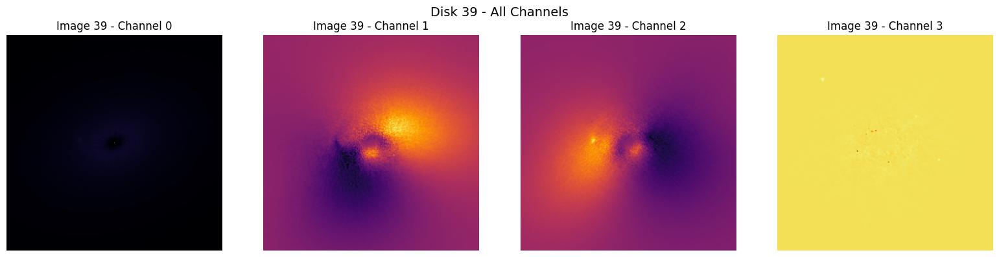

(600, 600, 4)


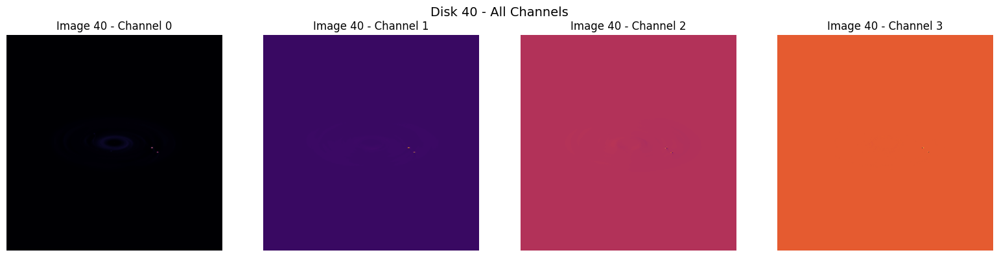

(600, 600, 4)


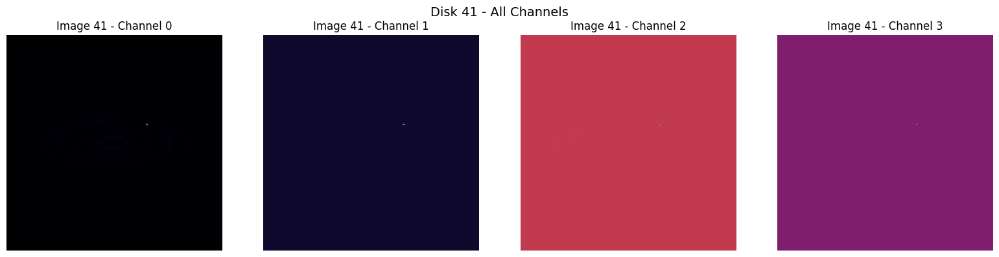

(600, 600, 4)


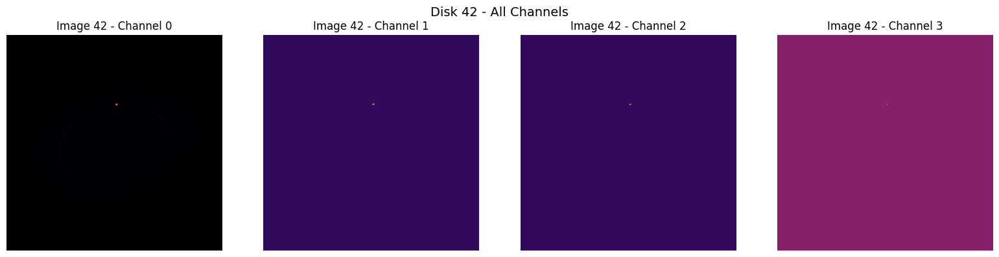

(600, 600, 4)


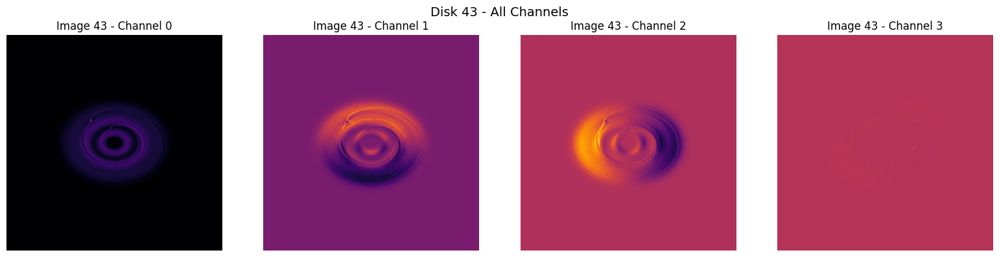

(600, 600, 4)


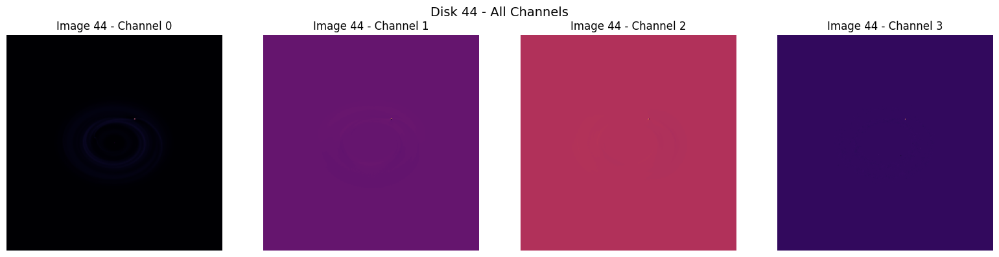

(600, 600, 4)


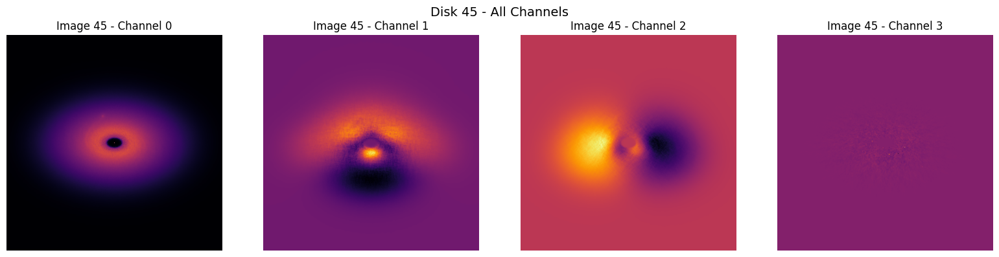

(600, 600, 4)


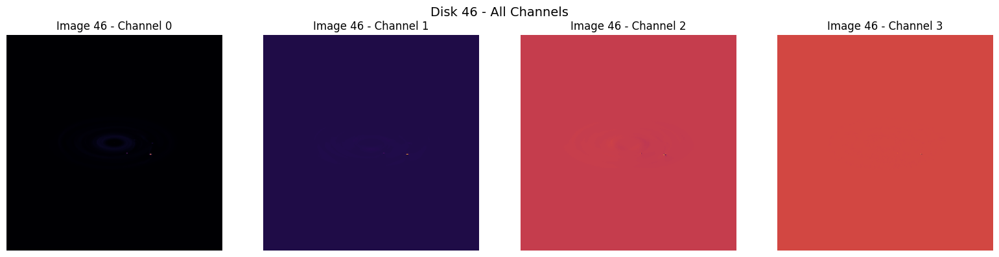

(600, 600, 4)


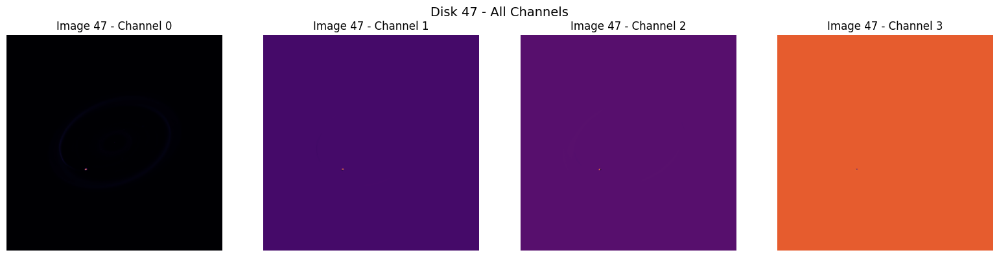

(600, 600, 4)


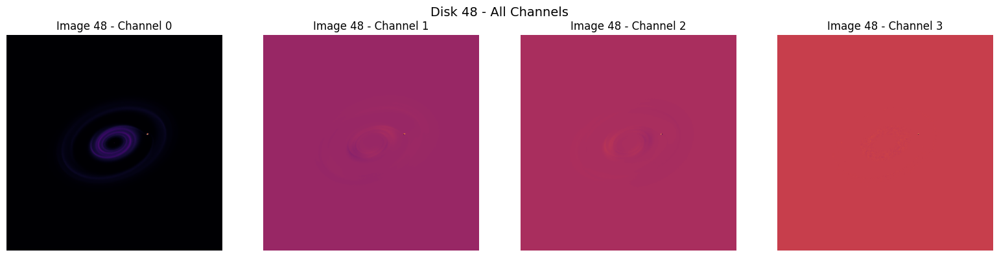

(600, 600, 4)


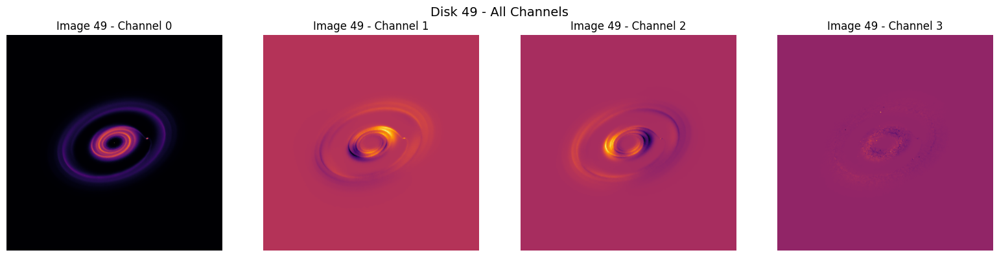

(600, 600, 4)


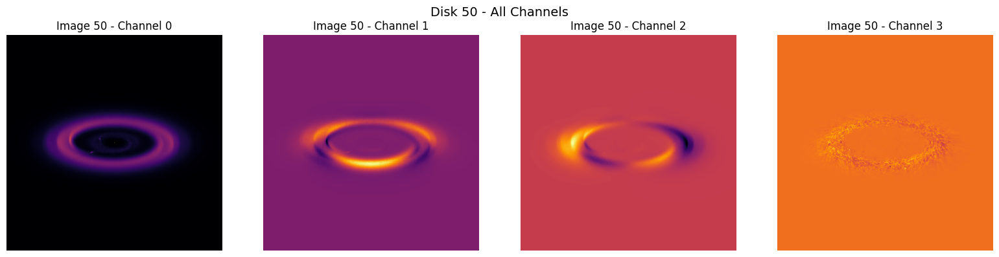

(600, 600, 4)


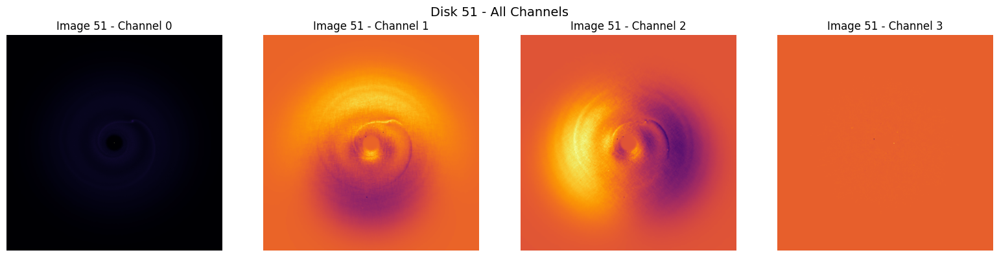

(600, 600, 4)


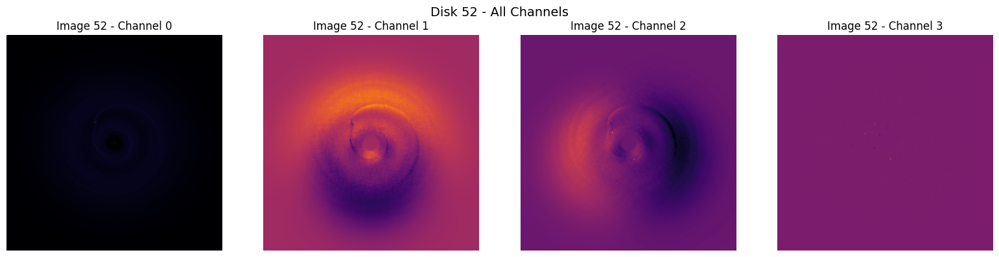

(600, 600, 4)


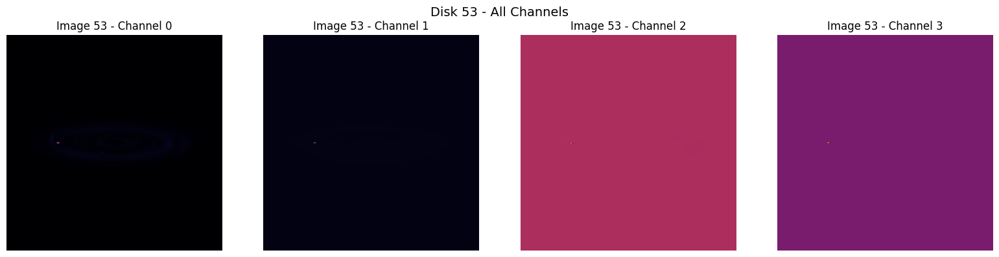

(600, 600, 4)


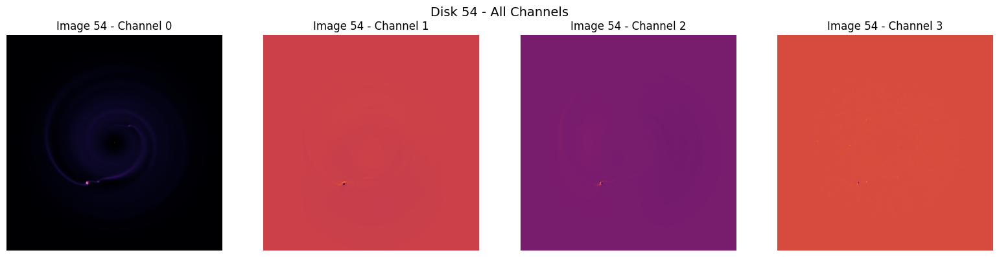

(600, 600, 4)


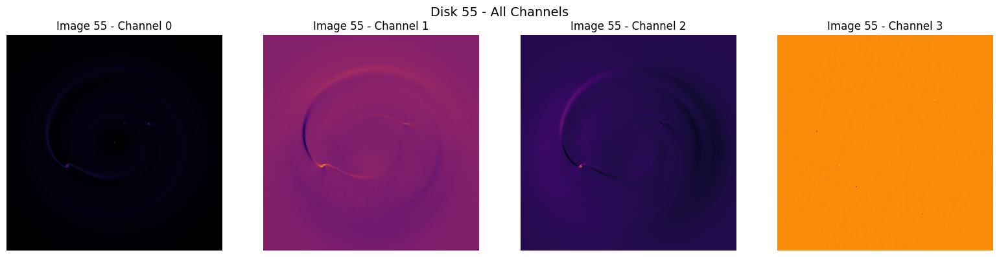

(600, 600, 4)


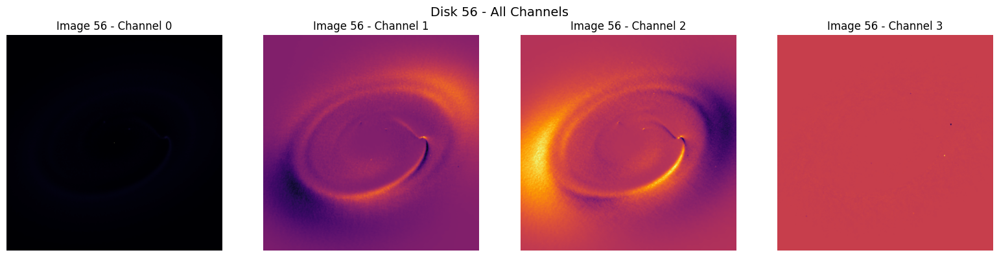

(600, 600, 4)


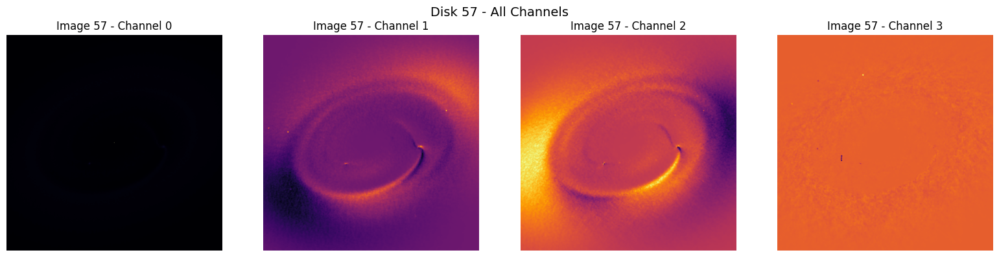

(600, 600, 4)


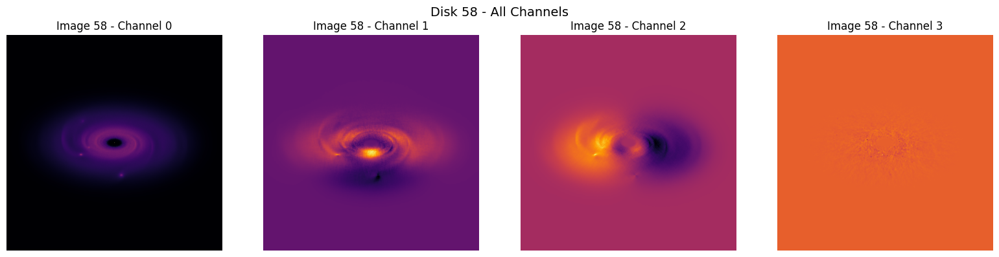

(600, 600, 4)


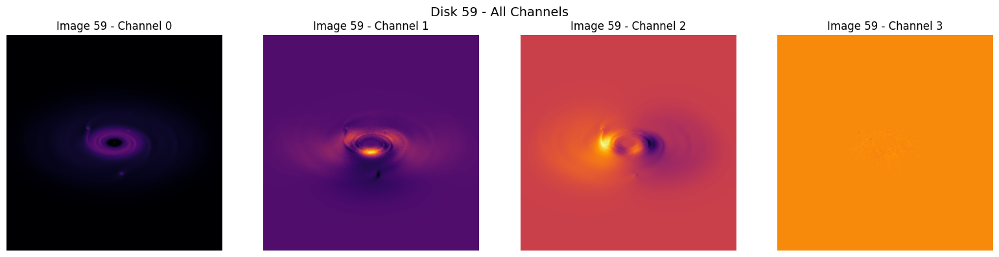

(600, 600, 4)


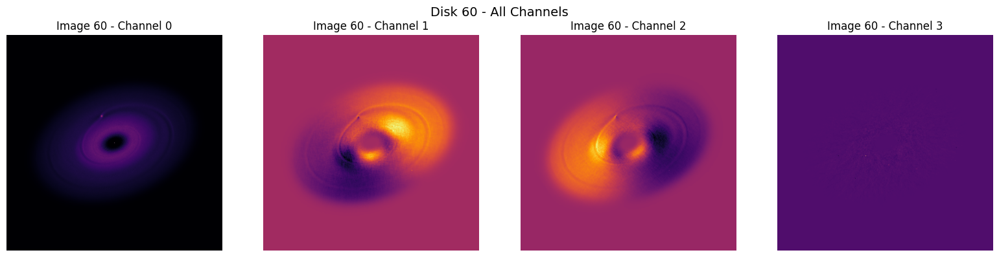

(600, 600, 4)


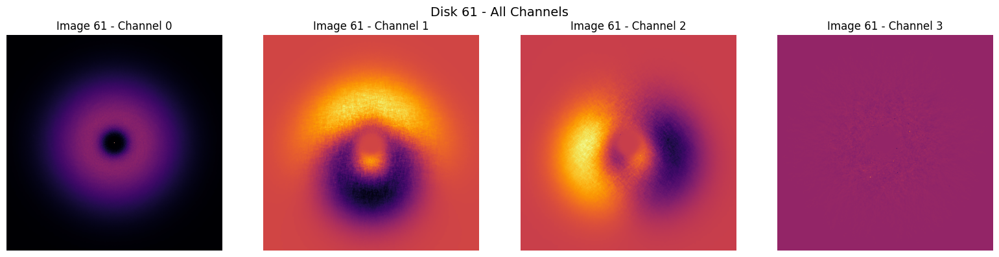

(600, 600, 4)


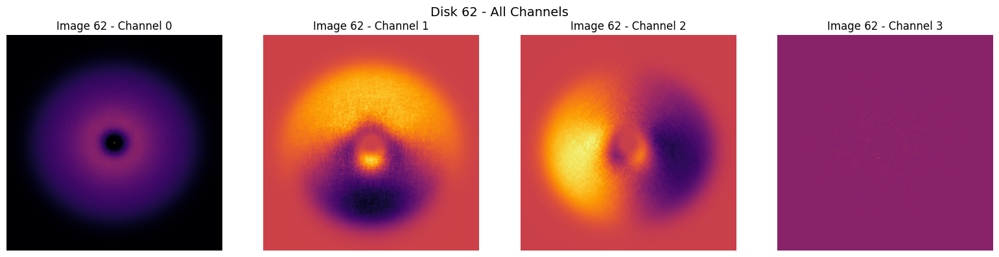

(600, 600, 4)


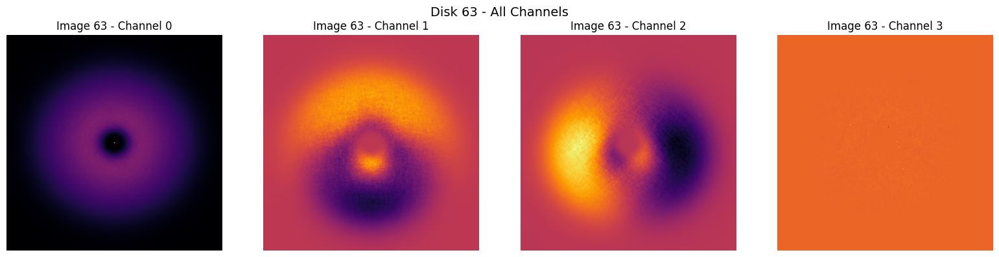

(600, 600, 4)


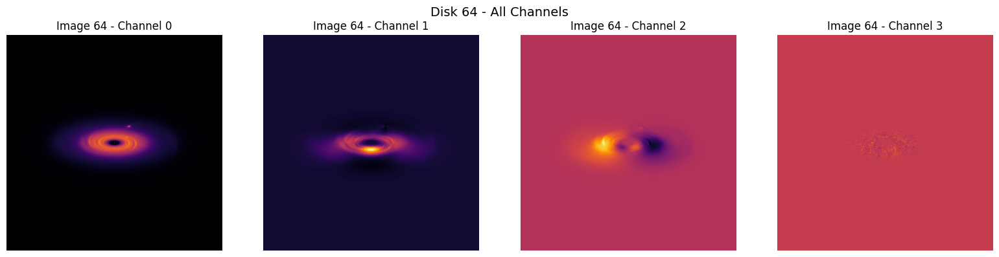

(600, 600, 4)


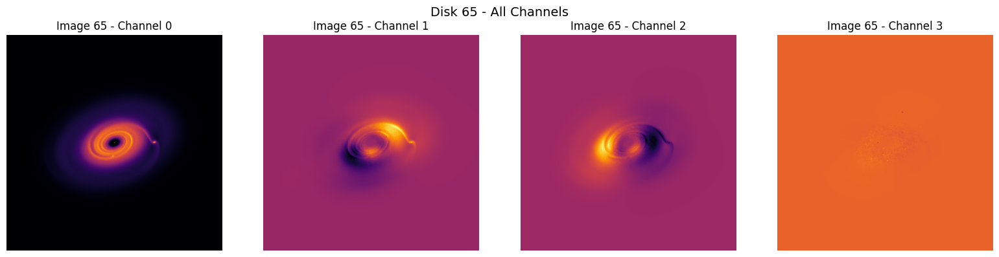

(600, 600, 4)


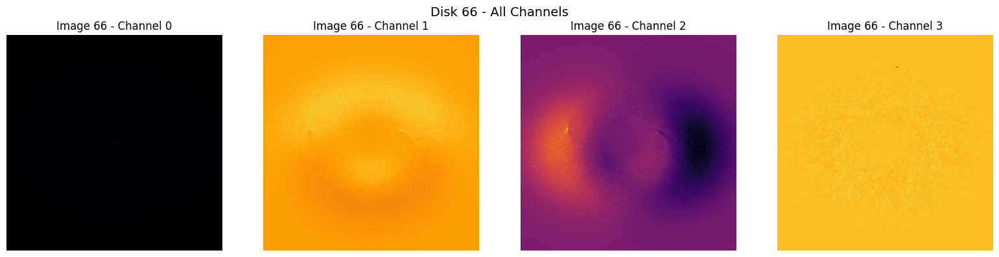

(600, 600, 4)


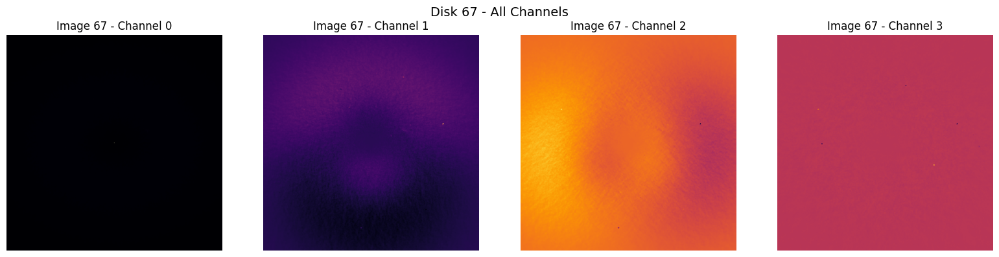

(600, 600, 4)


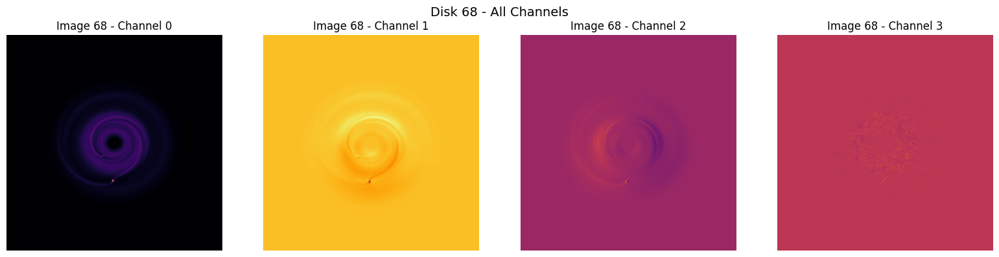

(600, 600, 4)


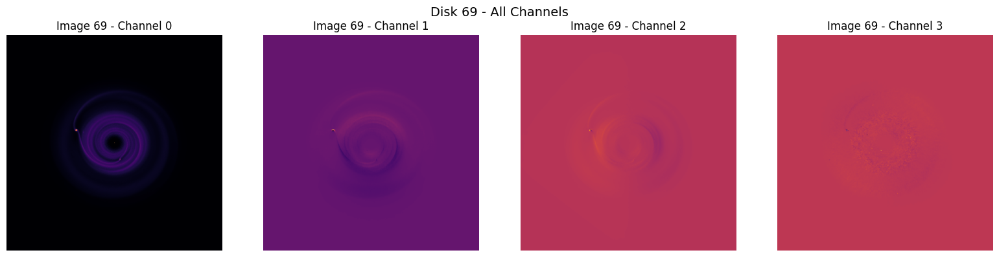

(600, 600, 4)


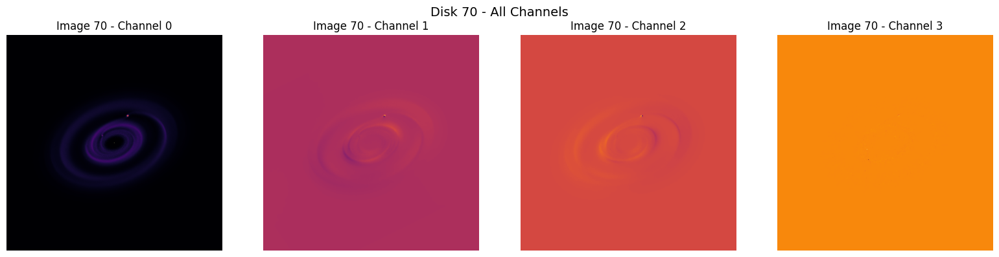

(600, 600, 4)


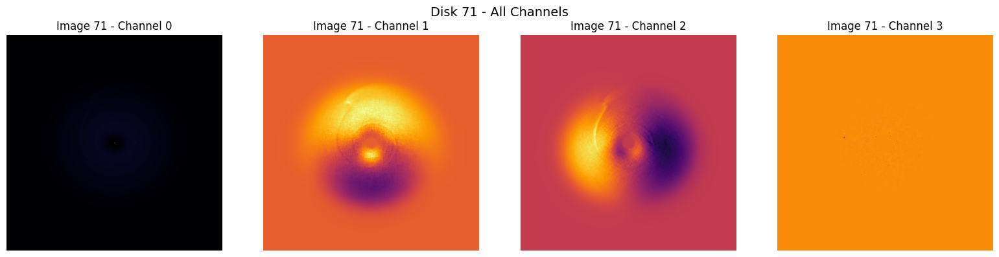

(600, 600, 4)


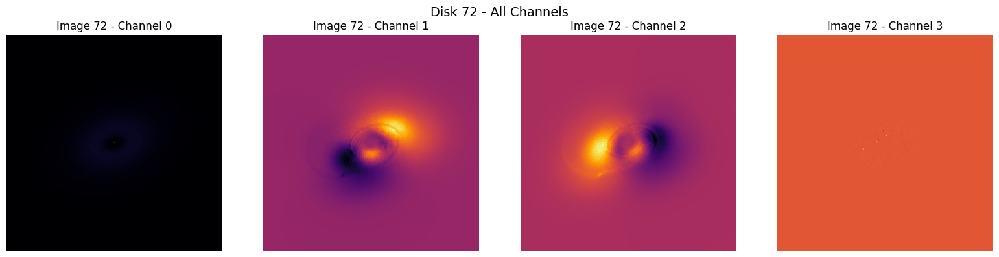

(600, 600, 4)


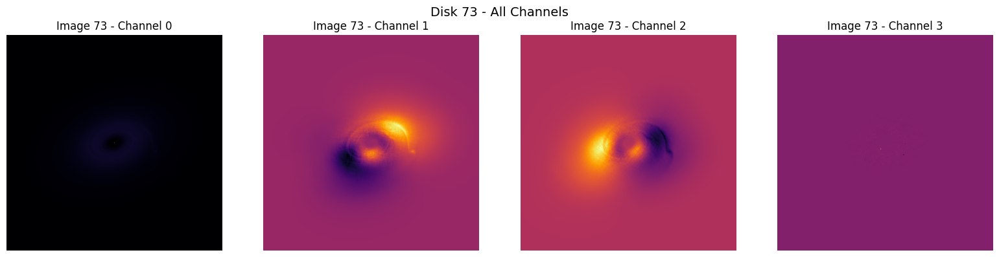

(600, 600, 4)


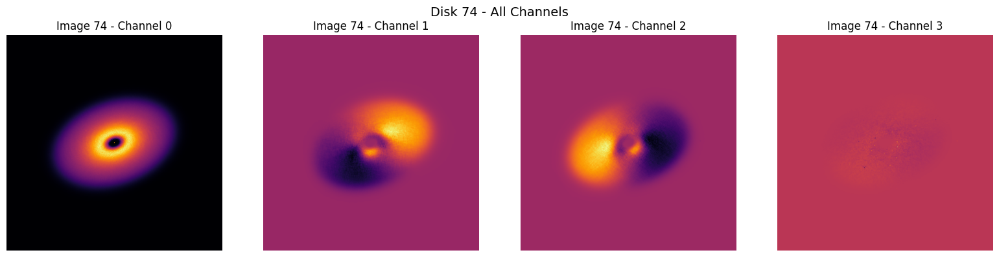

(600, 600, 4)


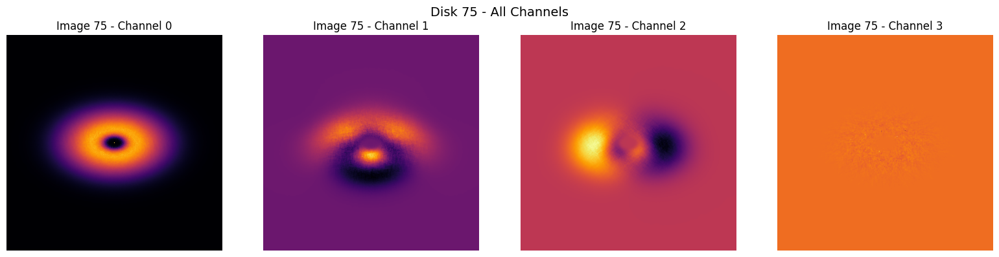

(600, 600, 4)


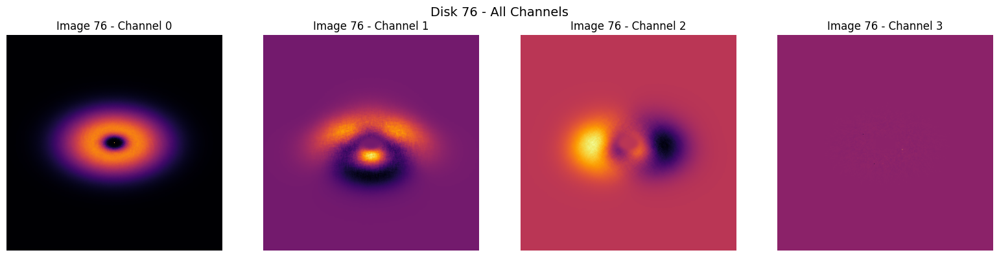

(600, 600, 4)


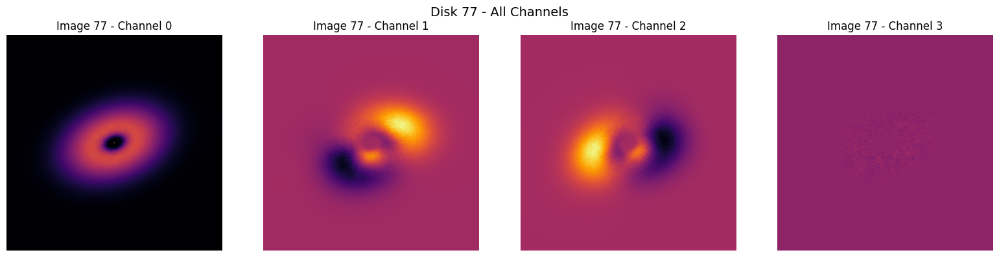

(600, 600, 4)


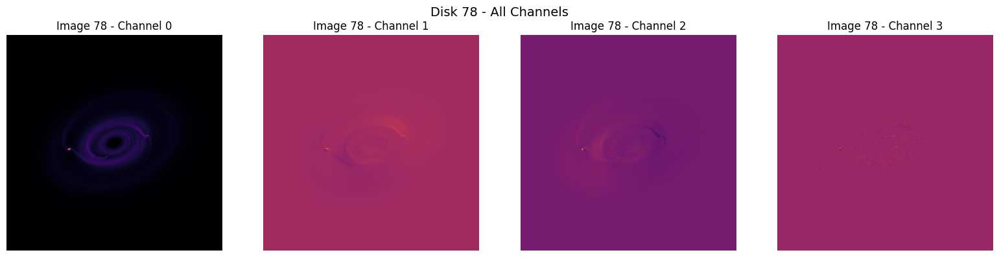

(600, 600, 4)


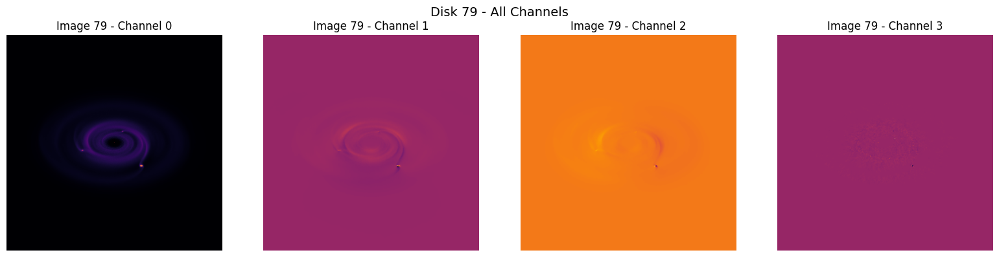

(600, 600, 4)


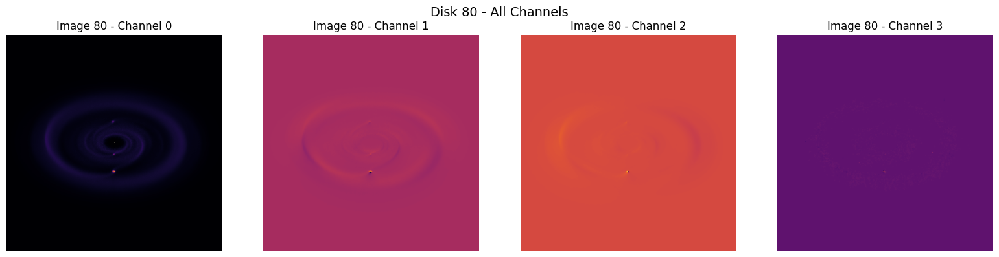

(600, 600, 4)


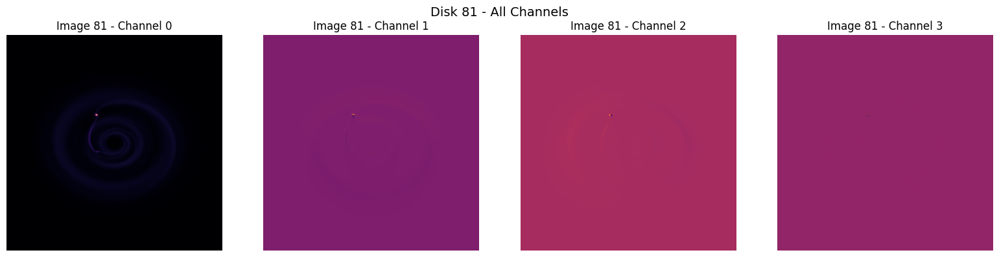

(600, 600, 4)


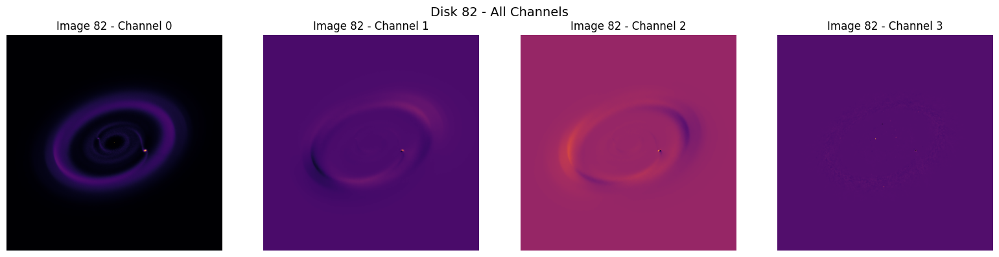

(600, 600, 4)


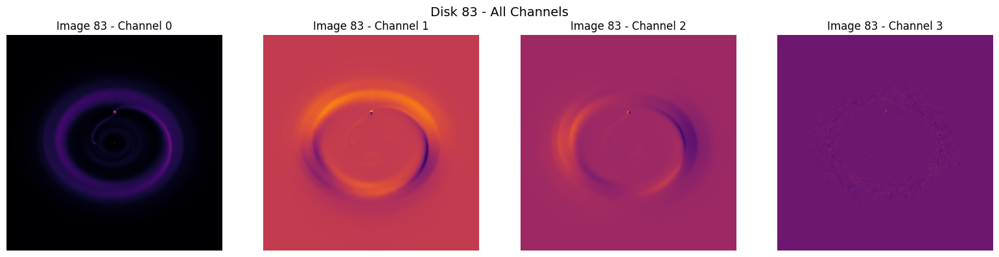

(600, 600, 4)


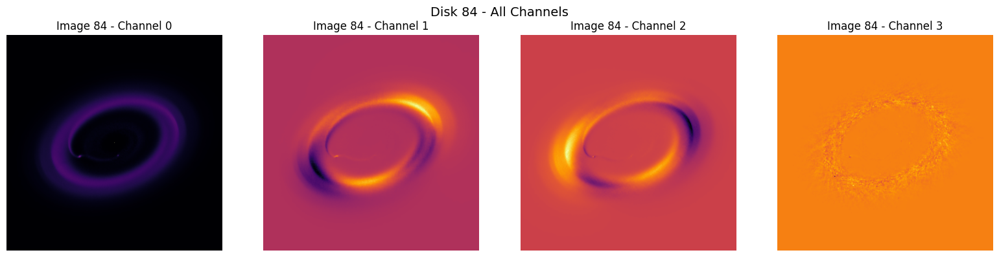

(600, 600, 4)


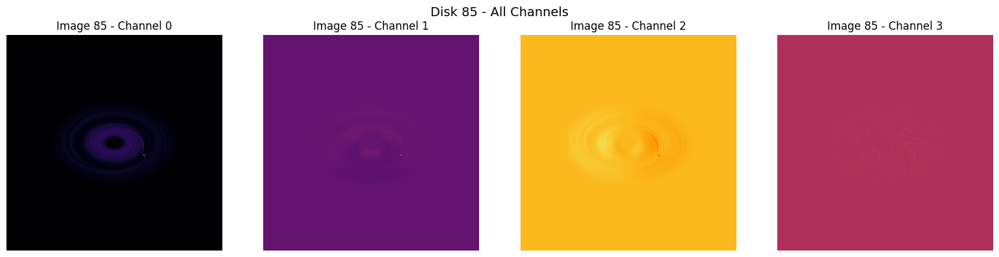

(600, 600, 4)


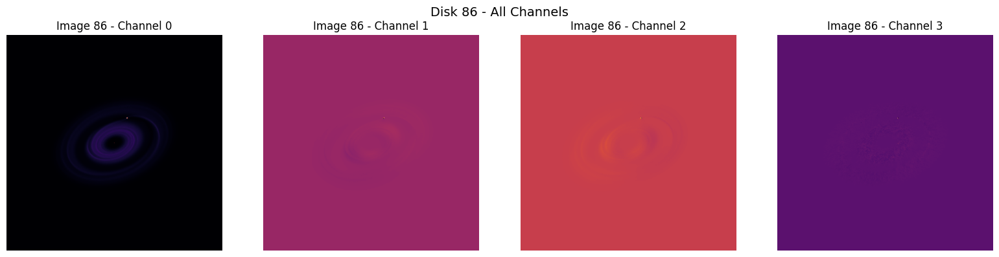

(600, 600, 4)


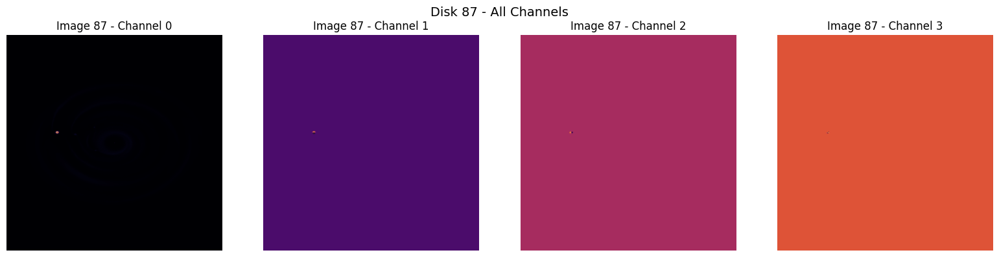

(600, 600, 4)


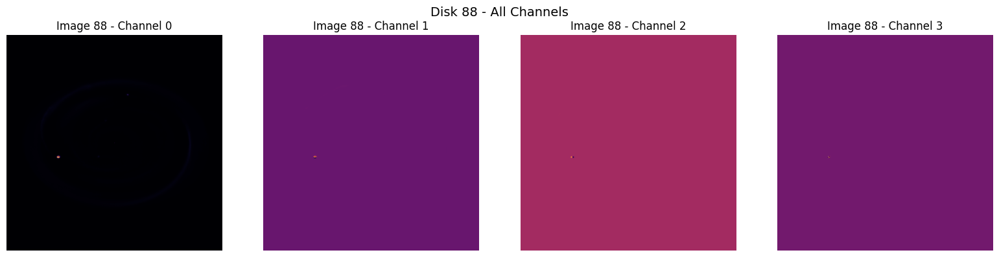

(600, 600, 4)


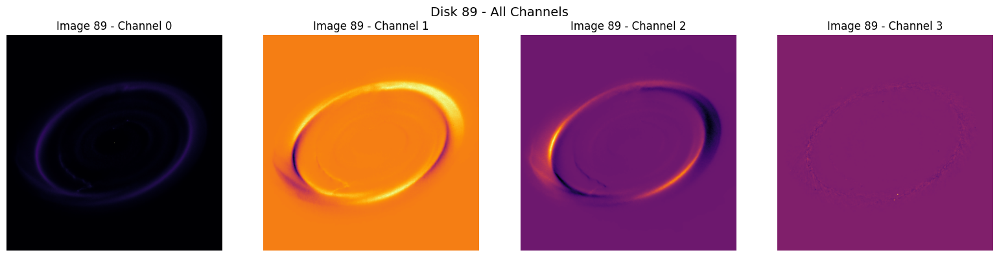

(600, 600, 4)


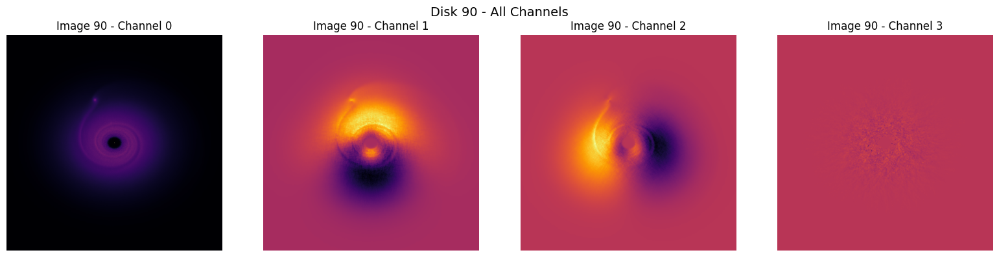

(600, 600, 4)


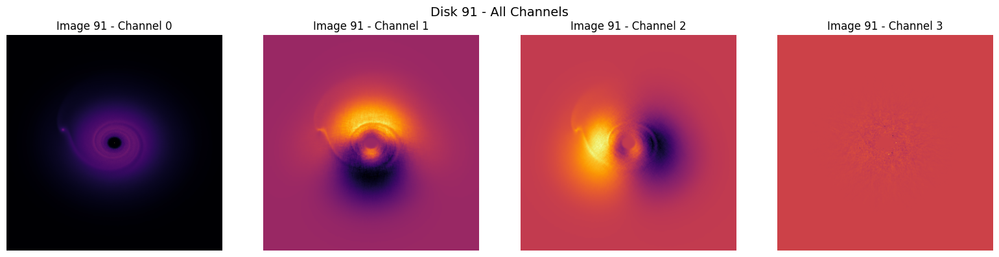

(600, 600, 4)


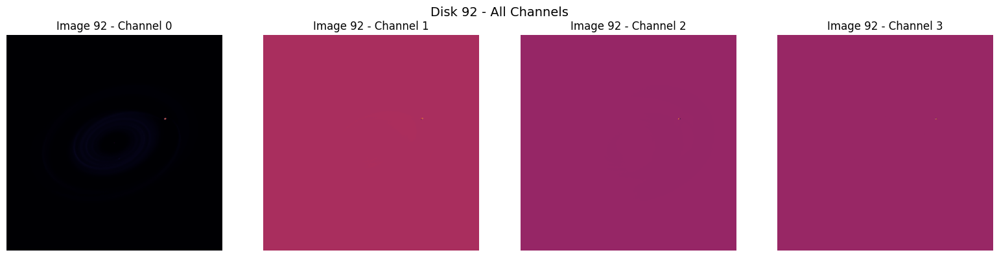

(600, 600, 4)


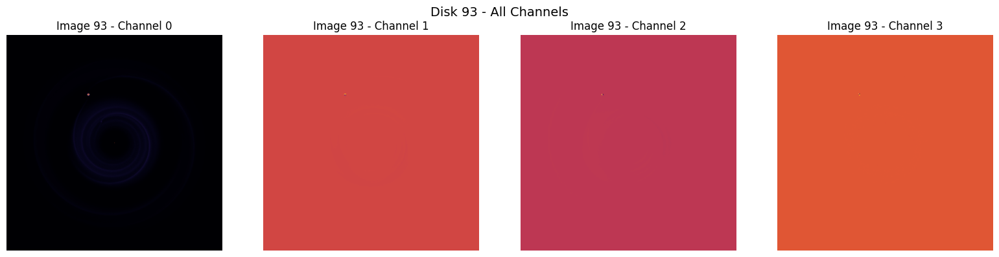

(600, 600, 4)


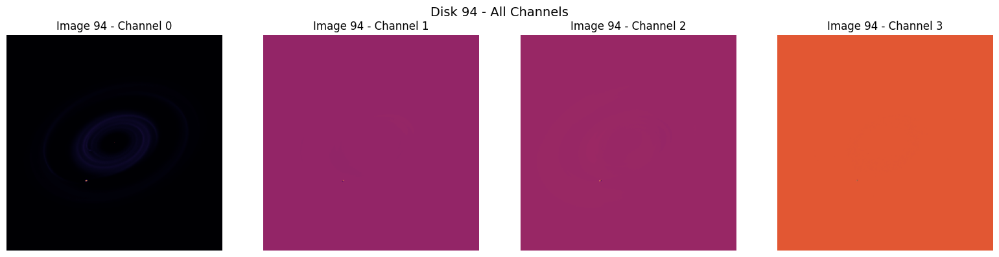

(600, 600, 4)


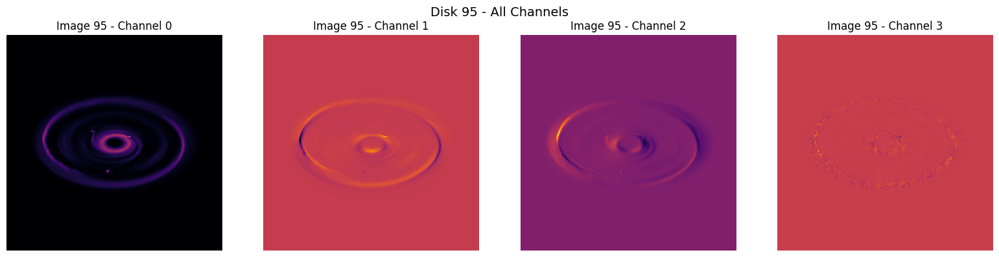

(600, 600, 4)


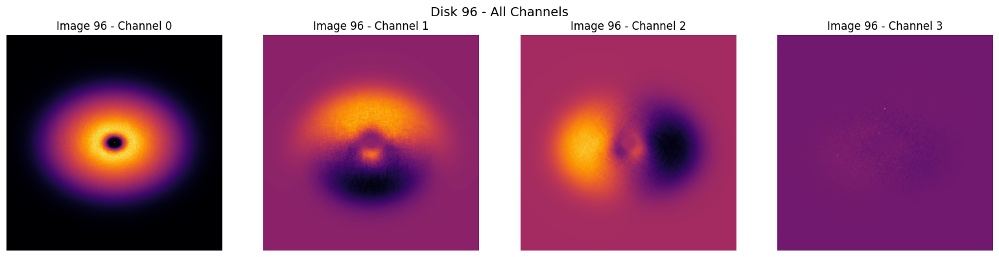

(600, 600, 4)


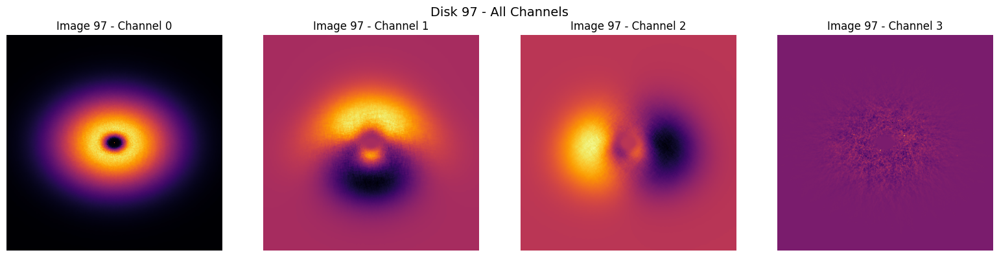

(600, 600, 4)


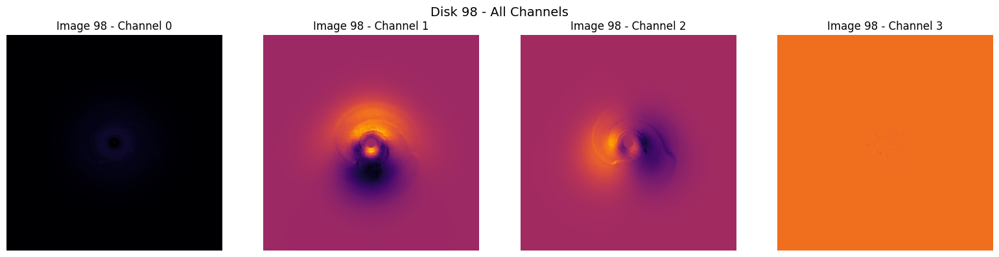

(600, 600, 4)


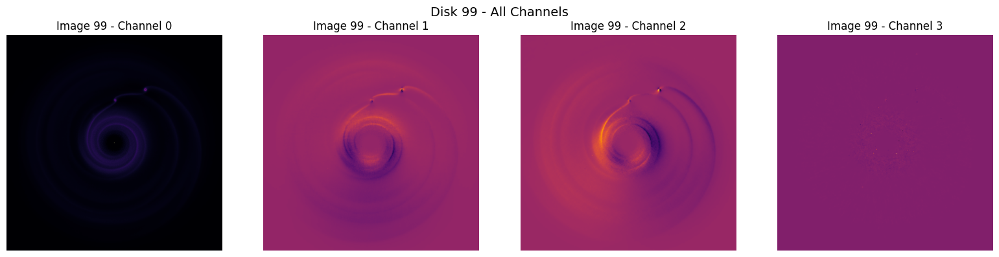

(600, 600, 4)


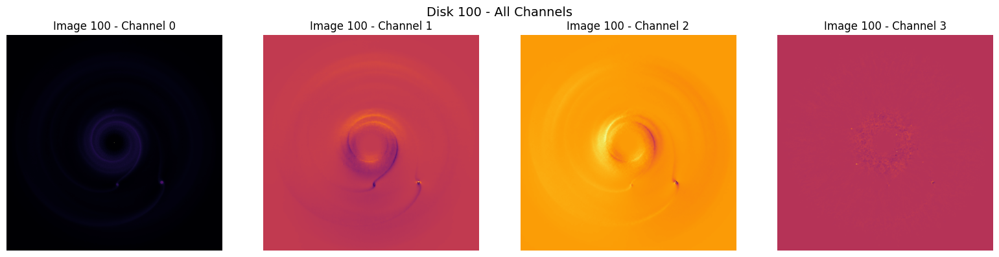

(600, 600, 4)


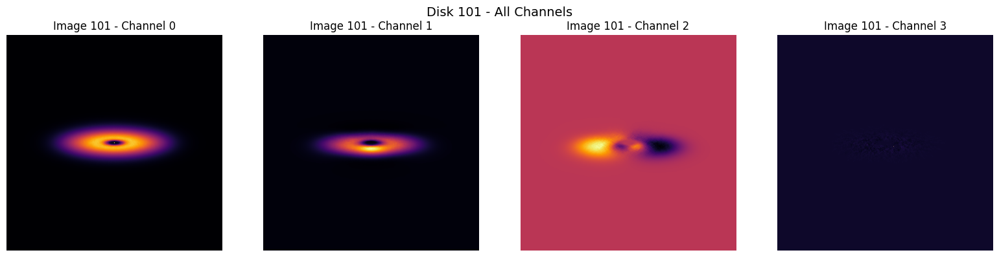

(600, 600, 4)


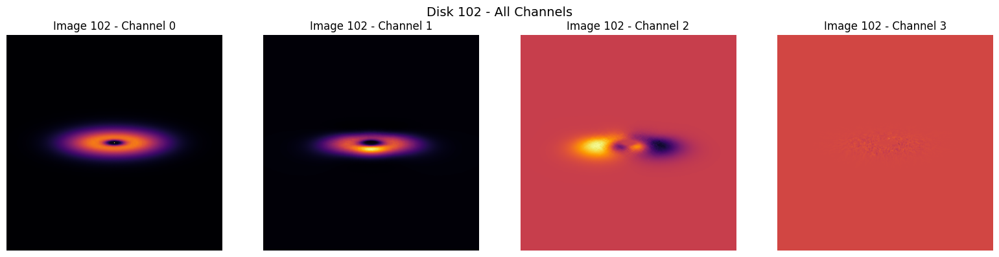

(600, 600, 4)


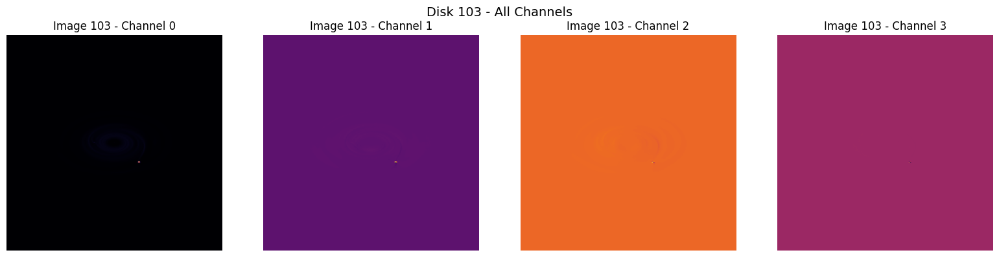

(600, 600, 4)


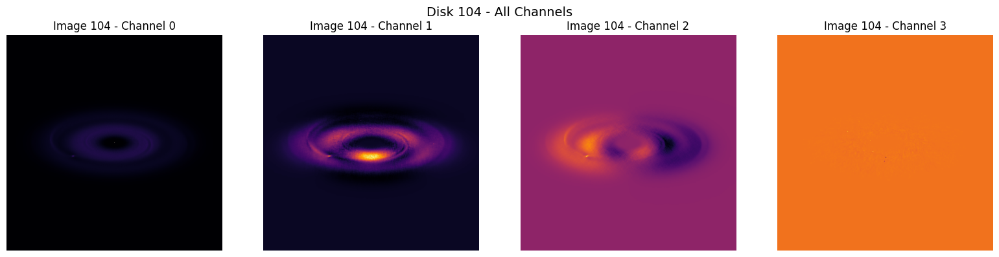

(600, 600, 4)


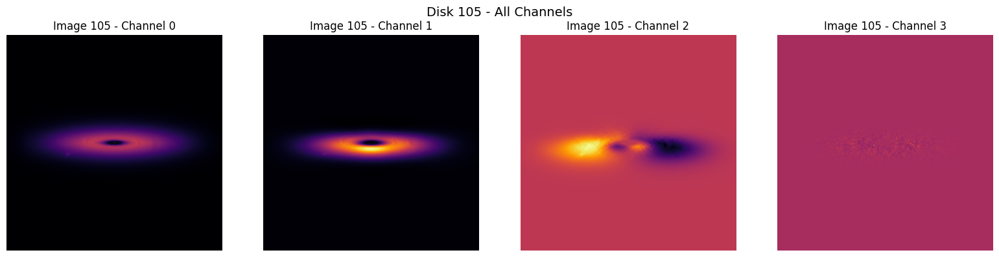

(600, 600, 4)


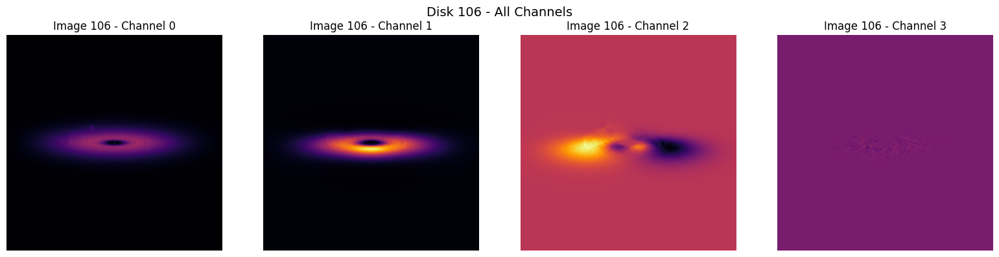

(600, 600, 4)


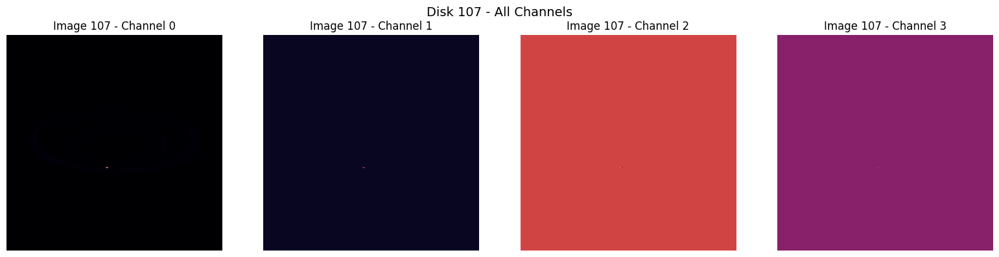

(600, 600, 4)


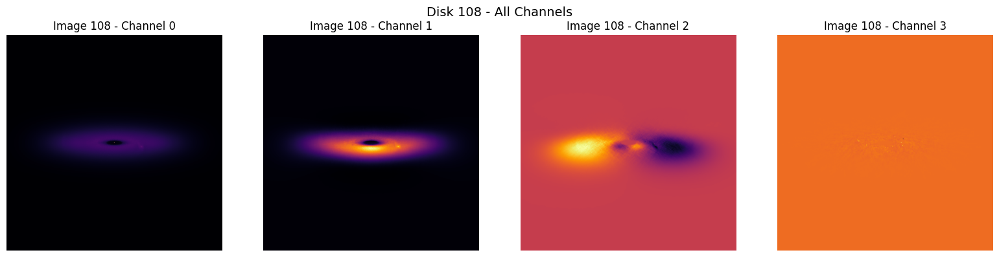

(600, 600, 4)


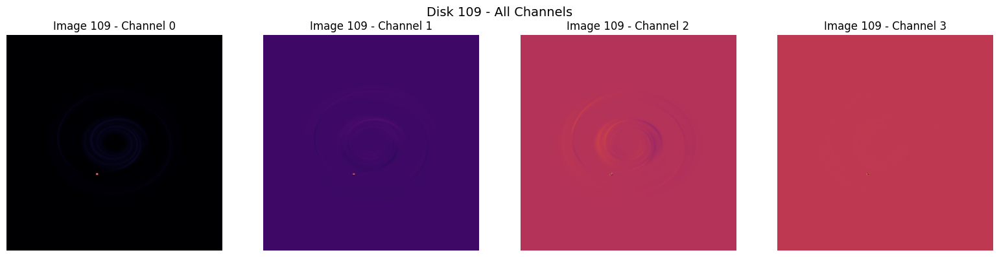

(600, 600, 4)


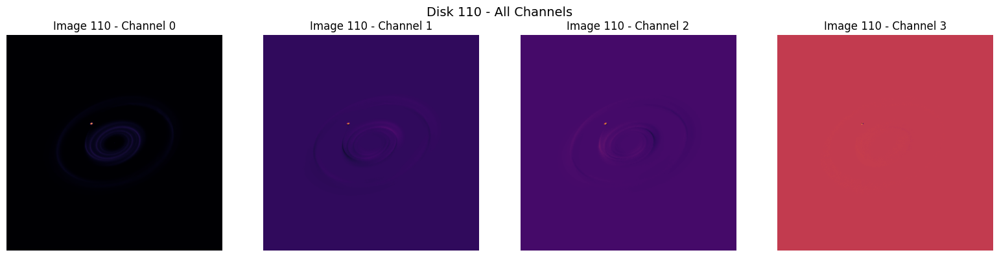

(600, 600, 4)


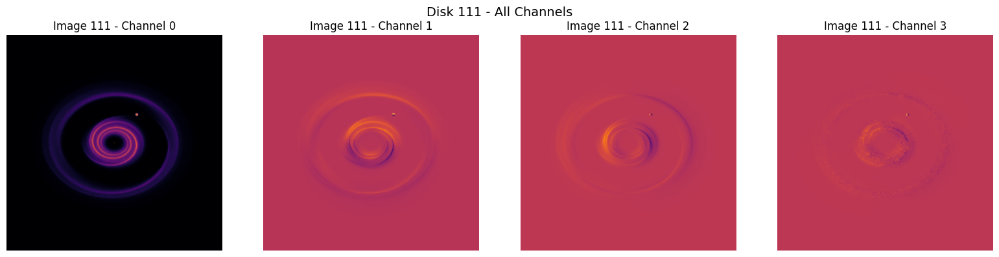

(600, 600, 4)


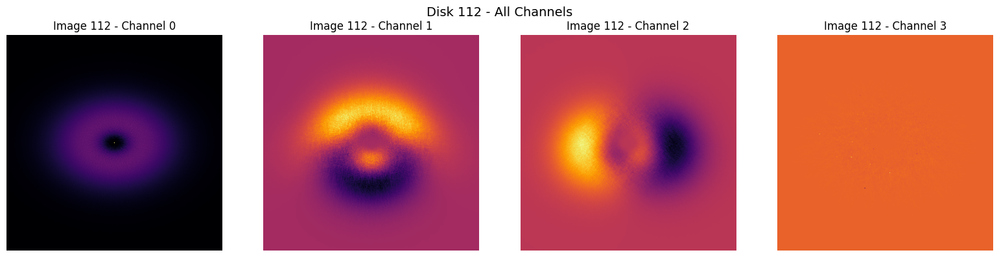

(600, 600, 4)


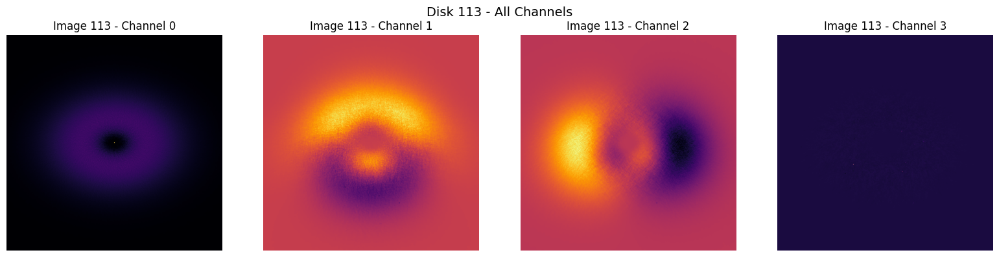

(600, 600, 4)


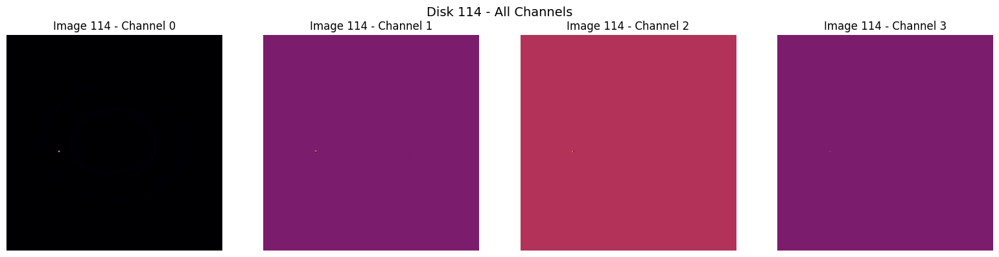

(600, 600, 4)


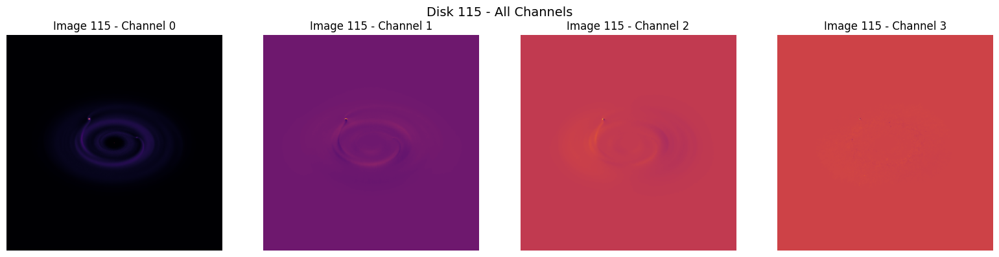

(600, 600, 4)


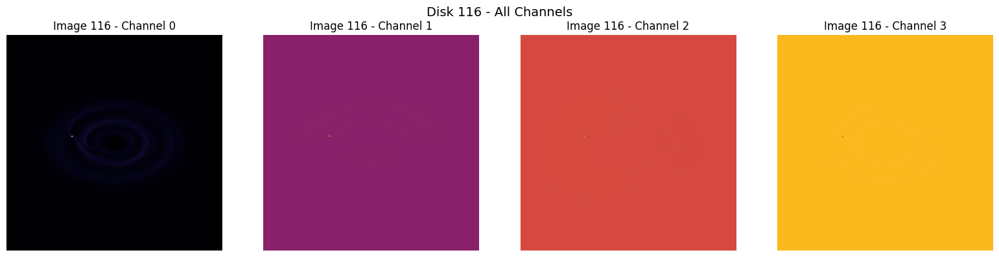

(600, 600, 4)


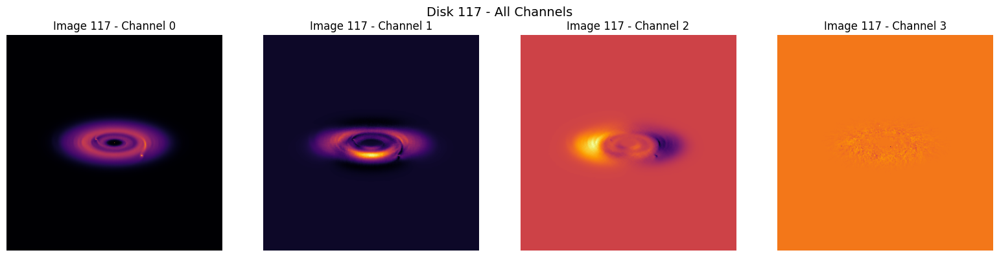

(600, 600, 4)


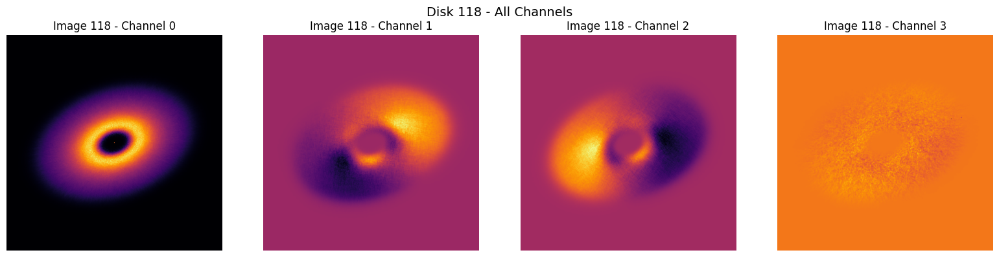

(600, 600, 4)


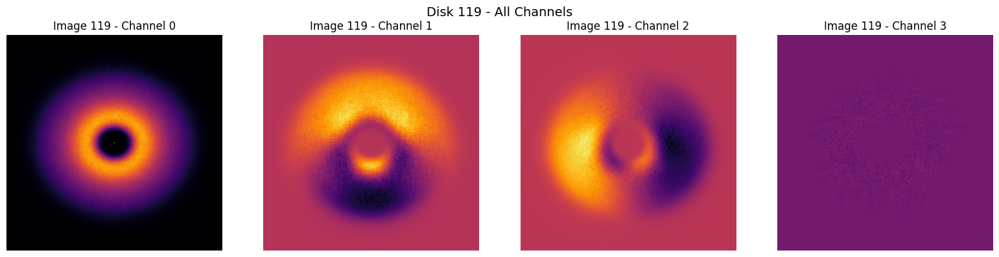

(600, 600, 4)


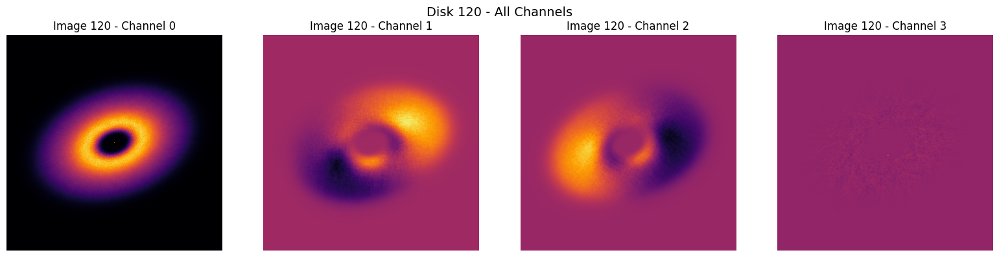

(600, 600, 4)


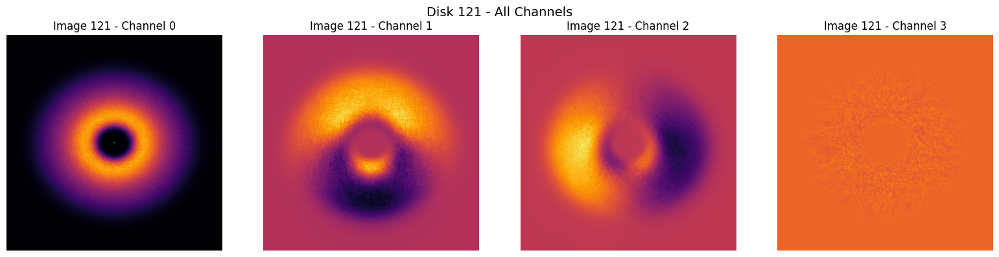

(600, 600, 4)


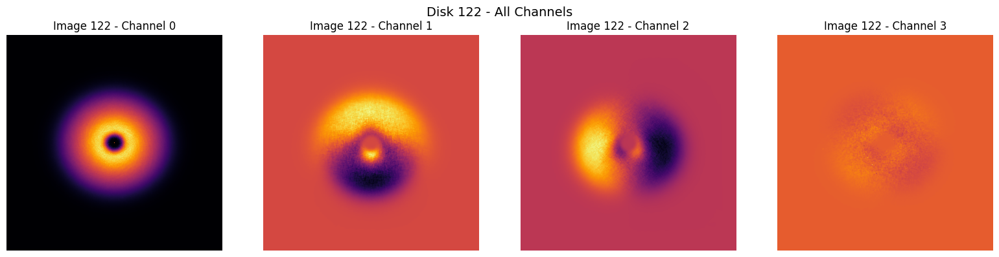

(600, 600, 4)


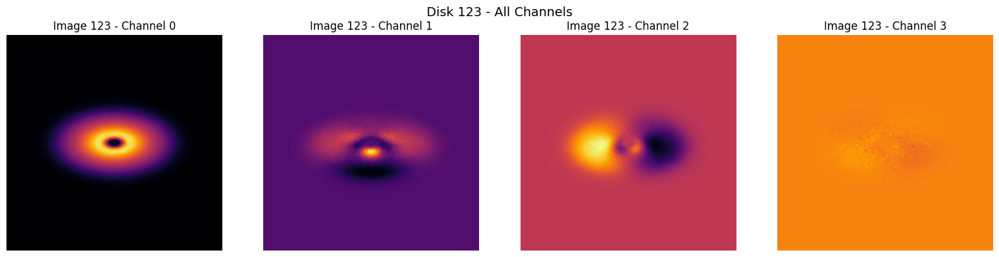

(600, 600, 4)


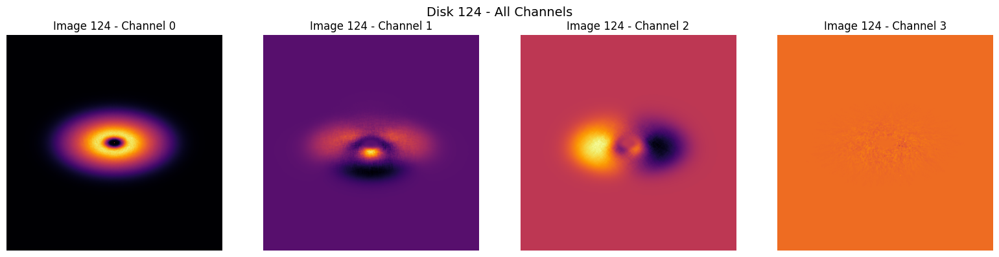

(600, 600, 4)


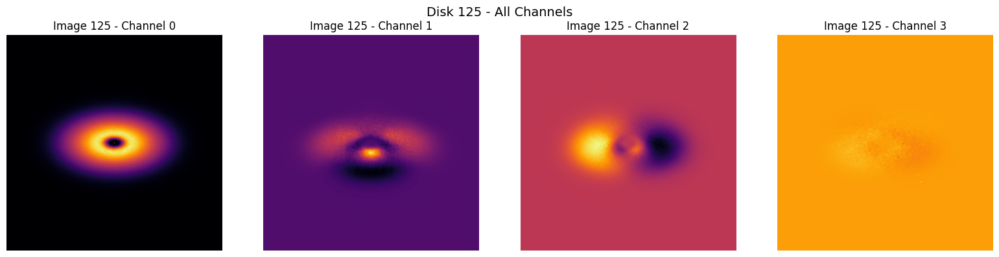

(600, 600, 4)


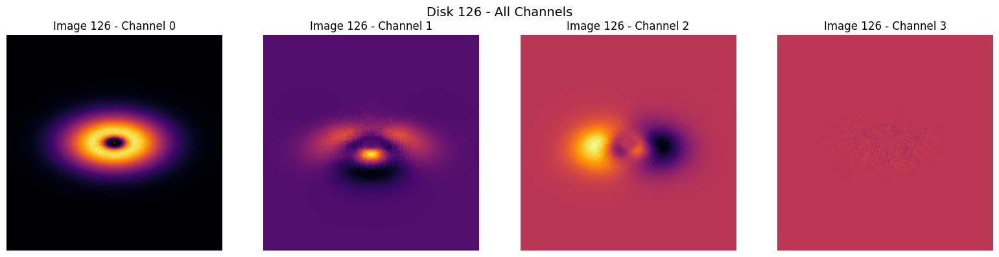

(600, 600, 4)


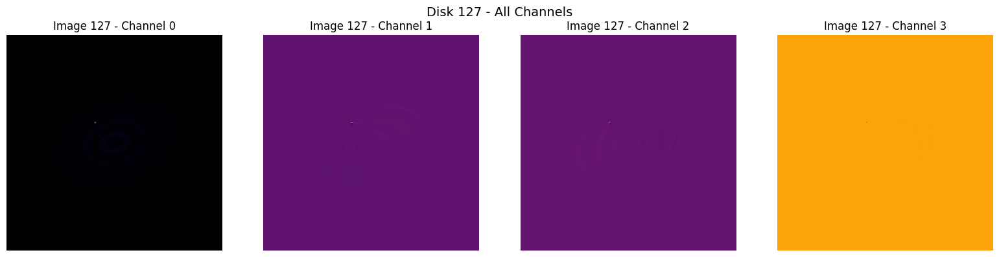

(600, 600, 4)


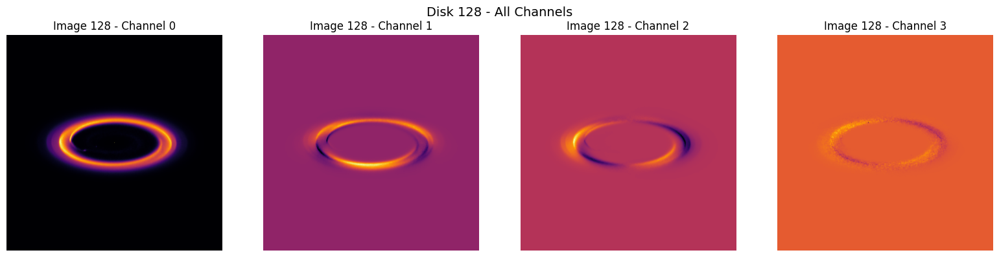

(600, 600, 4)


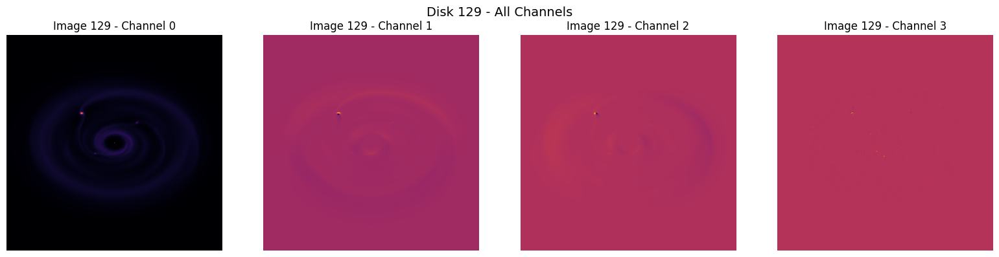

(600, 600, 4)


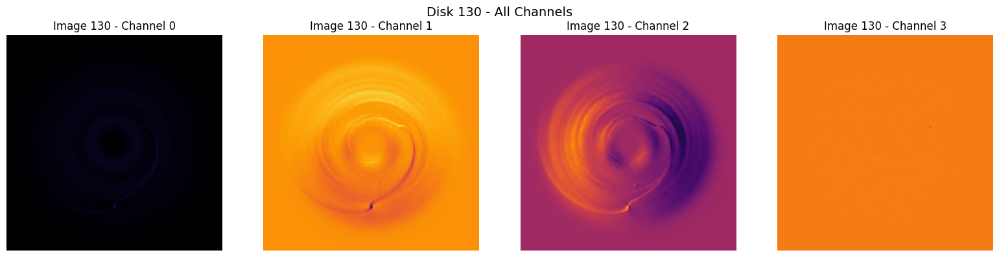

(600, 600, 4)


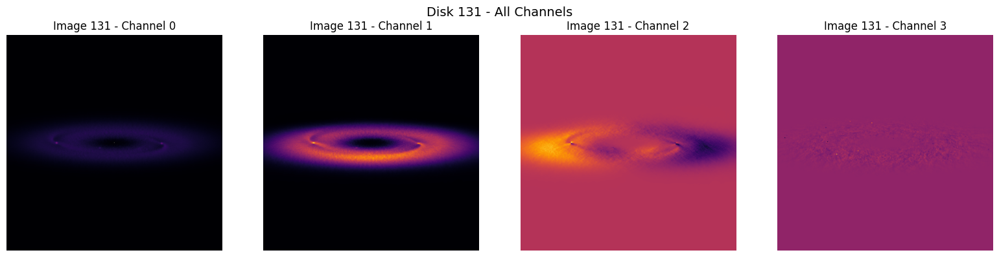

(600, 600, 4)


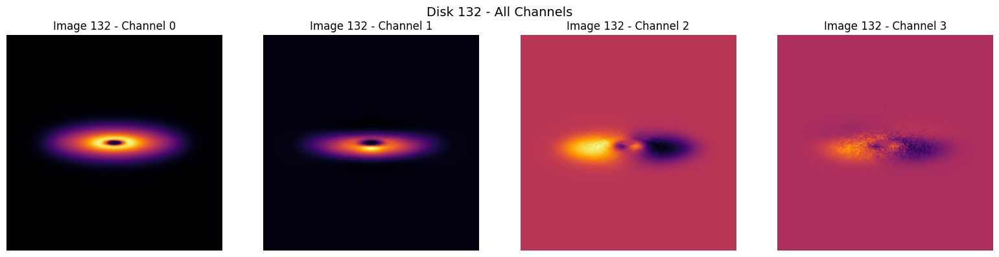

(600, 600, 4)


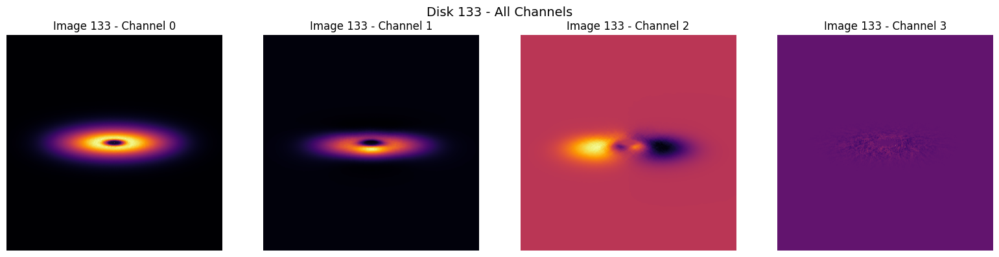

(600, 600, 4)


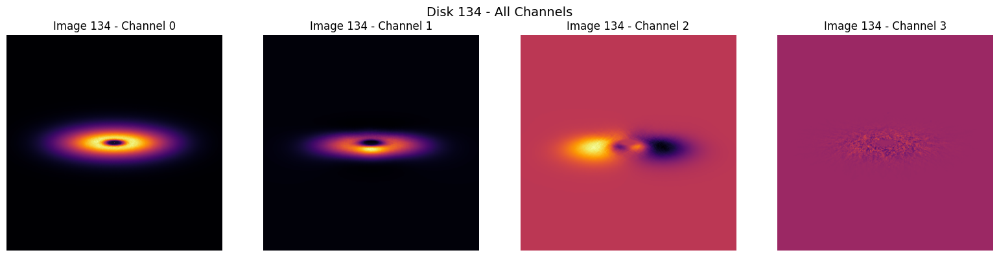

(600, 600, 4)


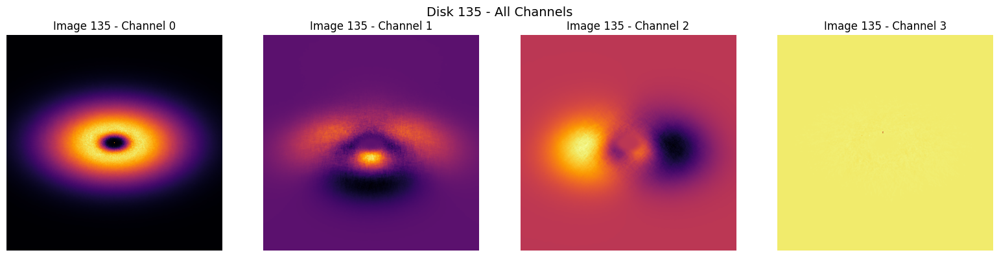

(600, 600, 4)


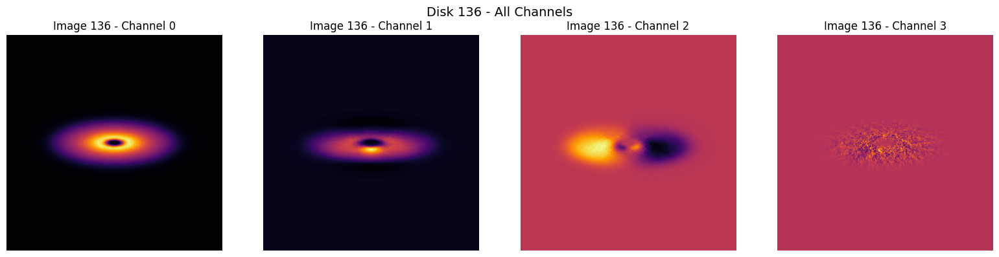

(600, 600, 4)


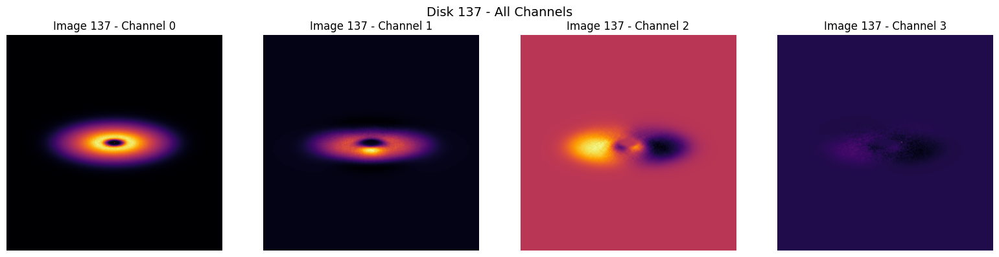

(600, 600, 4)


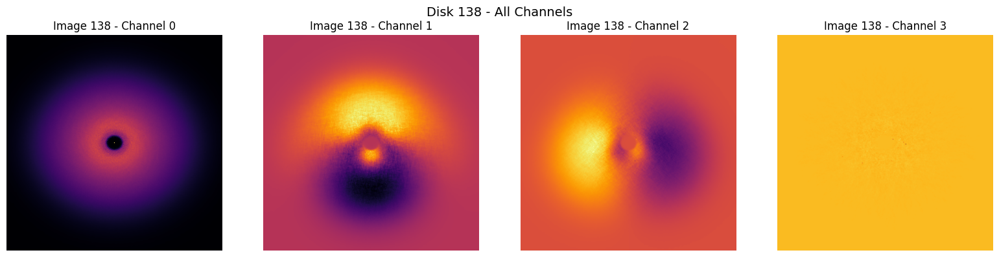

(600, 600, 4)


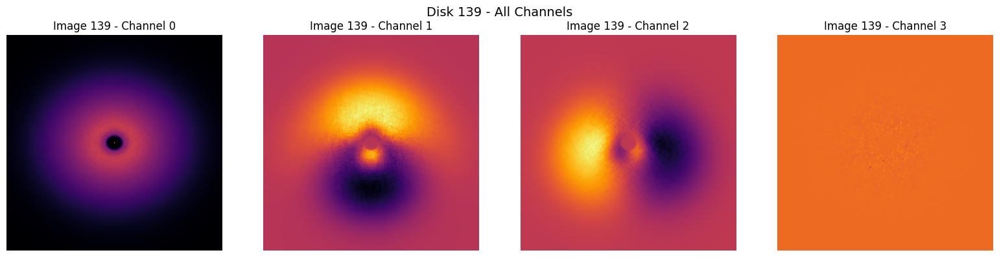

(600, 600, 4)


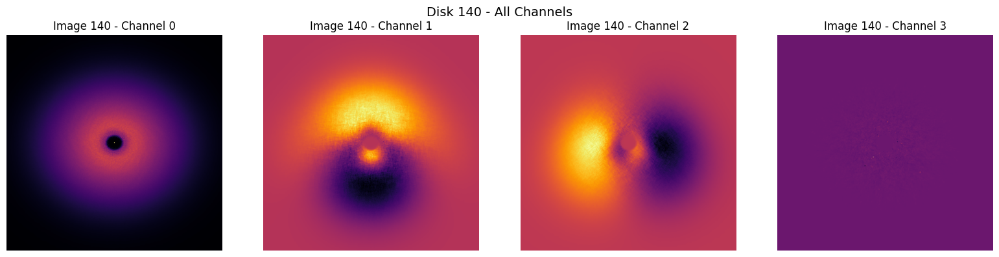

(600, 600, 4)


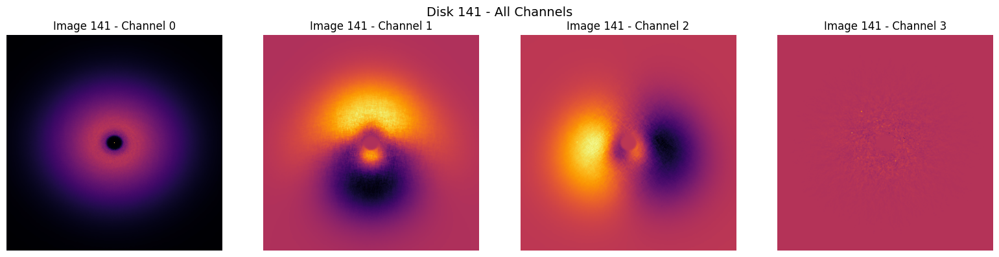

(600, 600, 4)


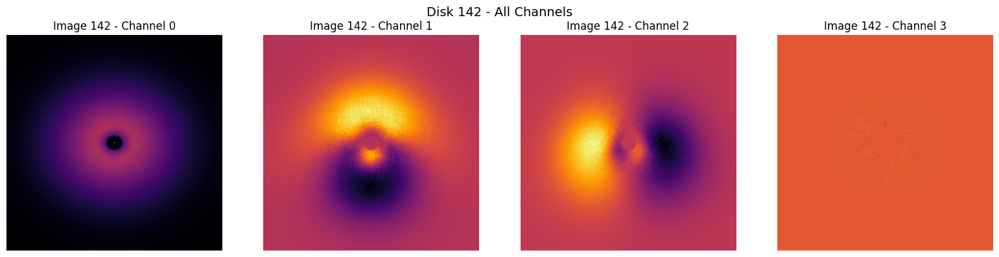

(600, 600, 4)


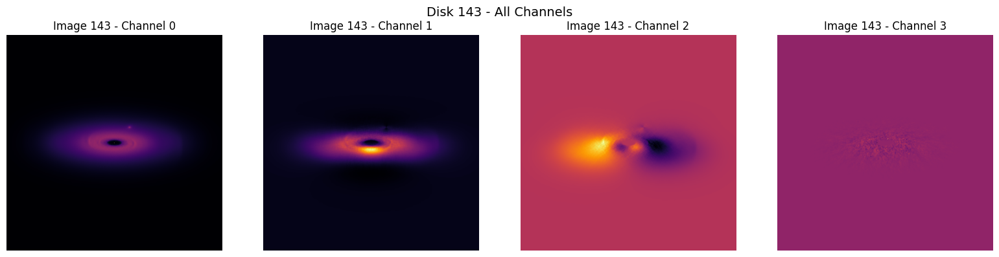

(600, 600, 4)


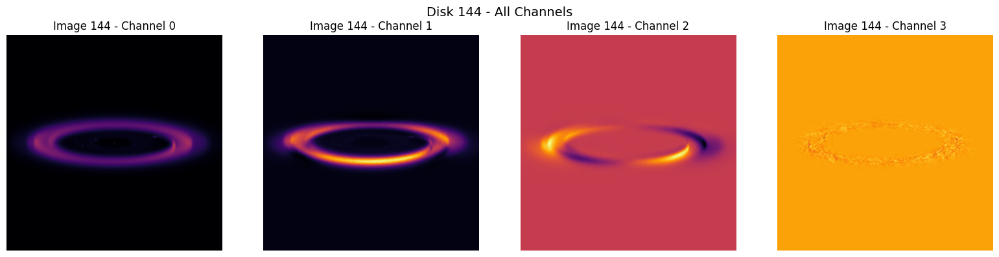

(600, 600, 4)


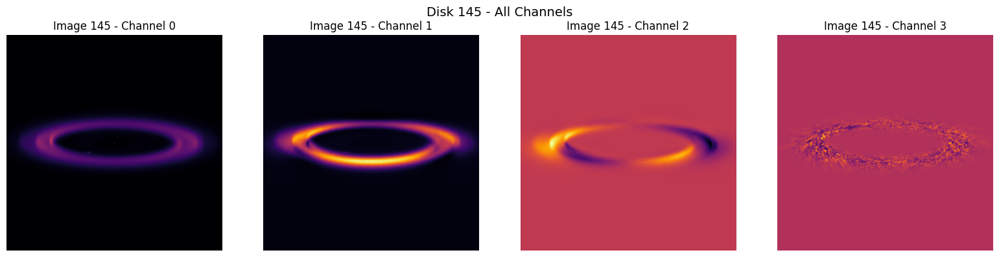

(600, 600, 4)


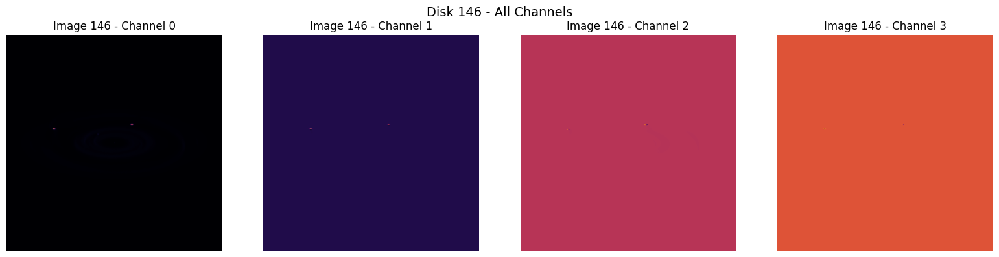

(600, 600, 4)


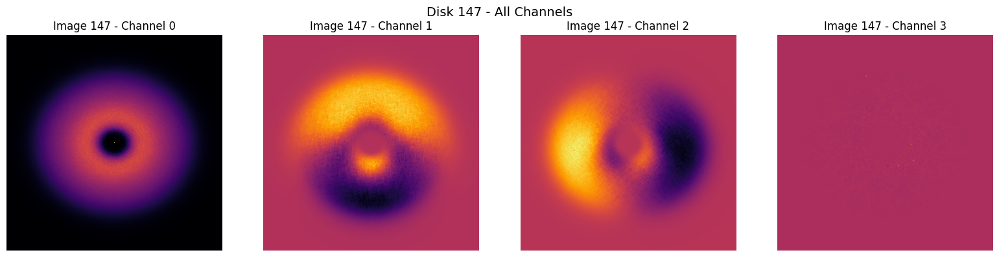

(600, 600, 4)


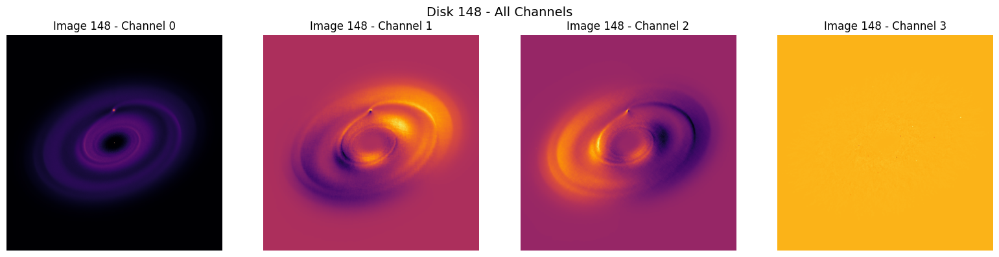

(600, 600, 4)


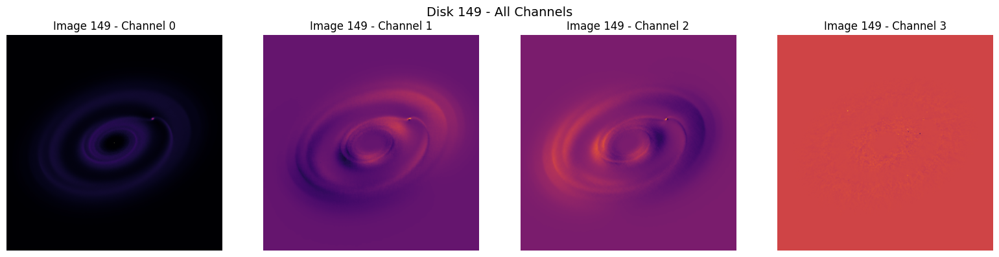

In [10]:

def visualize_all_disks(image_list, max_images=10):
    """
    Visualizes all disk images in the list (up to max_images).
    Each row contains the 4-channel views of one image.
    """
    num_images = min(len(image_list), max_images)

    for i in range(num_images):
        image = image_list[i]  # shape: (600, 600, 4)
        fig, axes = plt.subplots(1, 4, figsize=(16, 4))
        print(image.shape)
        for c in range(image.shape[2]):
            axes[c].imshow(image[:, :, c], cmap='inferno', origin='lower')
            axes[c].set_title(f"Image {i+1} - Channel {c}")
            axes[c].axis("off")

        plt.suptitle(f"Disk {i+1} - All Channels", fontsize=14)
        plt.tight_layout()
        plt.show()
visualize_all_disks(normalised, max_images=len(normalised))


**Observations**: I saw that channel 3 is not showing much features. Its either an entirely full color patch or having very minimal distortions.

Channels 1,2 are almost looking same, there will be a lot of redundant features, which we can remove to make the training faster,less weight.

I wanted to see whether I can quantify it somehow so that i can safely ignore , so i started with the PCA on this dataset and plotted the variance explained by the channels.




 channel mean variance: [9.1152852e-03 2.0834780e-10 2.1343464e-10 3.0140040e-13]

 channel mean intensity: [0.03882656 0.00014593 0.00014479 0.00014467]

 other channels corelation with channel 2
channel 0 vs channel 3: r =-0.0741
channel 1 vs channel 3: r =0.9977
channel 2 vs channel 3: r =0.9978

 explained ratio:  [9.9998492e-01 1.5082854e-05 2.0224080e-08 5.6336411e-09]


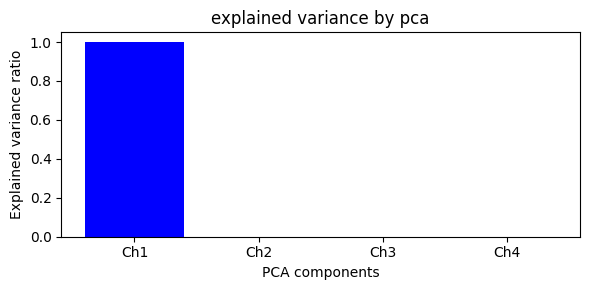

In [11]:

def analyze_channel_usefulness(image_list):
    image_array = np.array(image_list)  # shape: (N, H, W, 4)

    # Calculate variance of channels
    channel_vars = np.var(image_array, axis=(1, 2))  # shape: (N, 4)
    mean_channel_variance = np.mean(channel_vars, axis=0)
    print("\n channel mean variance:", mean_channel_variance)

    # Calculate mean intensity of channels
    mean_intensities = np.mean(image_array, axis=(1, 2))  # shape: (N, 4)
    mean_channel_intensity = np.mean(mean_intensities, axis=0)
    print("\n channel mean intensity:", mean_channel_intensity)

    # since on observation, channel 3 was not showing much inforation , lets see how it corelates with other channels
    print("\n other channels corelation with channel 2")
    flat_3 = image_array[:, :, :, 3].reshape(-1)
    for c in range(3):
        flat_c = image_array[:, :, :, c].reshape(-1)
        corr, _ = pearsonr(flat_c, flat_3)
        print(f"channel {c} vs channel 3: r ={corr:.4f}")

    # perform pca
    all_pixels = image_array.reshape(-1, 4)
    pca = PCA()
    pca.fit(all_pixels)
    print("\n explained ratio: ", pca.explained_variance_ratio_)



    # plot PCA and variance
    plt.figure(figsize=(6, 3))
    plt.bar(range(1, 5), pca.explained_variance_ratio_, tick_label=["Ch1", "Ch2", "Ch3", "Ch4"], color='blue')
    plt.title("explained variance by pca")
    plt.xlabel("PCA components")
    plt.ylabel("Explained variance ratio")
    plt.tight_layout()
    plt.show()


analyze_channel_usefulness(normalised)

Now with this, i decided to use only channel 0 to train the model . Later i thought that i will use both channel 0 and 1 and check which is working better. So for instance, im using only channel 0

***MODEL BUILDING***

First , I revisited  through the brief, I need a classifier to classify the samples depending on the properties like having planets, rings etc. In image task, it was given that they need an autoencoder, so i planned like the following.




1. Build an autoencoder model, compress each of the image to a latent dimension and try reconstructing from this latent dimension( this was the image task given)

2. After 1 , fix the model, pass the images through this model, extract latents,then pass these latents to the classifier and check the result


*Choice of model * :

a. First I tried a **simple autoencoder** and checked with step 1 .

Hyperspectral data is high-dimensional and noisy and autoencoder can learn a compact representation,removing irrelevant variation while retaining key patterns .

Result :  It was not showing a good reconstruction. Lots of noise and lots of distortions.
b. I shifted to a Variational autoencoder so I can take advantage of the overall distribution and regularise the latent space.

Result :






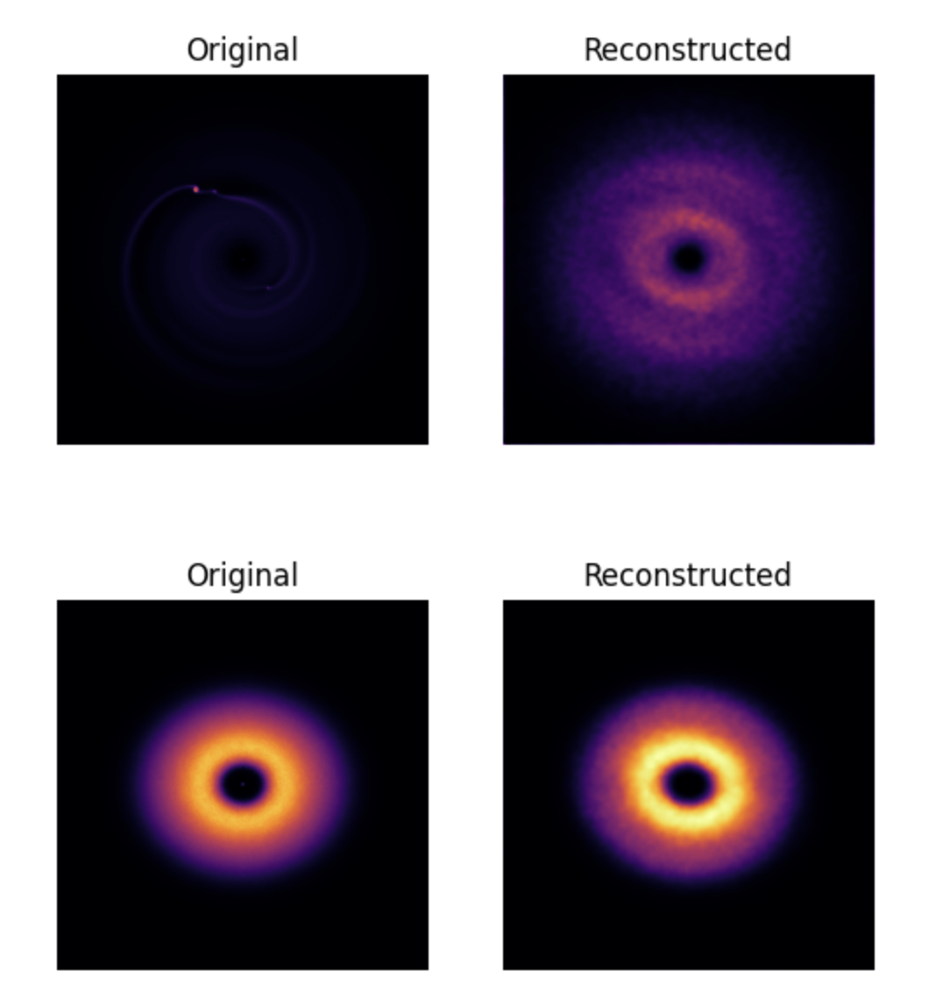

In [ ]:
display(Image(filename='/content/VAE_RECON_RESUL.png', width=400))

Observation : Light pixels are quite intensified and granurality, lots of grains.This suggests the VAE is not  preserving the spectral and spatial features well.

The VAE Model :

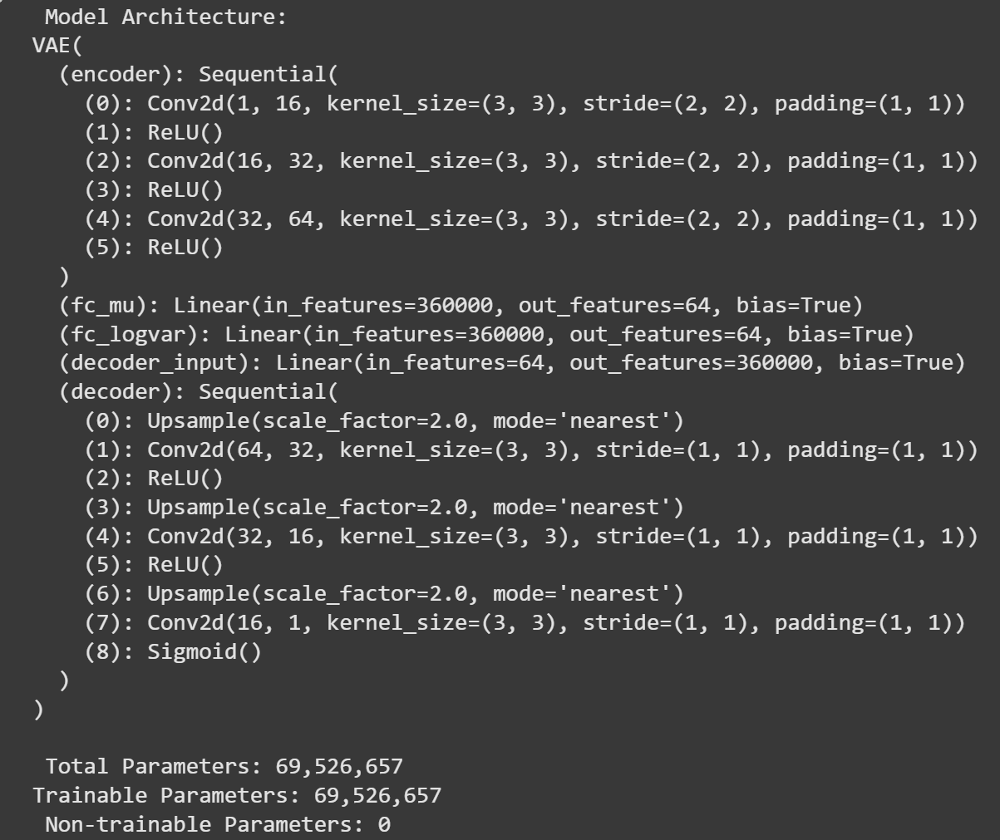





**Loss functions used **:

I used a combined loss of **VAE loss** , which is a combination of MSE loss and KL divergence and SSIM loss

The SSIM loss helps to improve the perceptual quality of reconstructed hyperspectral images.

SSIM measures luminance, contrast, and structural similarity.

ref : https://jack-roubaud.medium.com/working-with-structural-similarity-index-86ace619f408



Following this , I thought to try with **Alexnet** for extracting latent features, hoping for better results.

The architecture used :



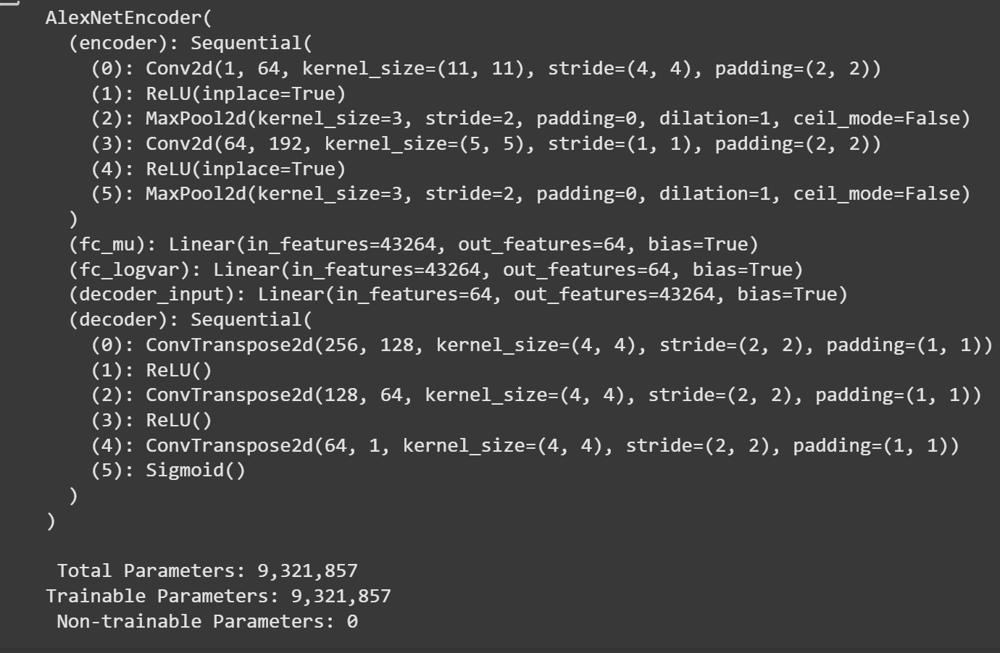

In [ ]:
display(Image(filename='/content/alexnet_archi.png', width=400))

**Result**

No big difference in results, more or less same as VAE results above


**Unet architecture with skip connections** ( **BEST** working so far for reconstruction)

Reason to use :  
My major issue with the generation was that my models did not learn the fine features and overall patterns across the image and also i felt that information was lost during encoding about the brightness , presence of exoplanets and light curves. So i thought that i might need skip connections to retain these fine information

ConvAutoencoder(autoencoder with conv layers): **HIGHEST**  silhoutte score so far



**MODEL IMPLEMENTATION AND TESTING **

The following contains different models implementation we discussed so far. I have structured it so that the user has to change the name as per the following to change between the models and specify the other hyperparameters as you wish




Flow of pipeline

1.   Dataset creation , to load inside dataloader for batch processing
2.   Define the models ,

*   Unet with skip connections
*   VAE
*   Alexnet-VAE , encoder i used alexnet layers
*   ConvAutoencoder

3. Select the channels to be used

4. Split the dataset into train,val and test and create the dataloaders.

5. Train the model

6. Plot the train-val losses

7. Extract the latents from the trained model

8. Use PCA and T-SNE to reduce and visualise

9. Cluster the train,val,test and overall dataset using clustering algorithms like K-Means,GMM,HDBSCAN.( experiment to check how the data is distributed across the splits )

10. For each of the clusters, take some n_samples(default at 5) and view the original image corresponding to that cluster



In [12]:
"""
Dataset creation
"""
class MultiChannelDataset(Dataset):
    def __init__(self, image_list):
        data = np.array(image_list, dtype=np.float32)
        self.data = torch.tensor(data).permute(0, 3, 1, 2)  # (N, C, H, W)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.data[idx]

In [13]:
class SkipUNet(nn.Module):
    def __init__(self, in_channels=1, latent_dim=64):
        super().__init__()
        self.enc1 = nn.Sequential(nn.Conv2d(in_channels, 16, 3, padding=1), nn.ReLU(), nn.MaxPool2d(2))
        self.enc2 = nn.Sequential(nn.Conv2d(16, 32, 3, padding=1), nn.ReLU(), nn.MaxPool2d(2))
        self.enc3 = nn.Sequential(nn.Conv2d(32, 64, 3, padding=1), nn.ReLU(), nn.MaxPool2d(2))
        self.flatten_dim = 64 * 75 * 75
        self.fc_mu = nn.Linear(self.flatten_dim, latent_dim)
        self.fc_logvar = nn.Linear(self.flatten_dim, latent_dim)
        self.decoder_input = nn.Linear(latent_dim, self.flatten_dim)
        self.dec1 = nn.Sequential(nn.Upsample(scale_factor=2), nn.Conv2d(64, 32, 3, padding=1), nn.ReLU())
        self.dec2 = nn.Sequential(nn.Upsample(scale_factor=2), nn.Conv2d(64, 16, 3, padding=1), nn.ReLU())
        self.dec3 = nn.Sequential(nn.Upsample(scale_factor=2), nn.Conv2d(32, in_channels, 3, padding=1), nn.Tanh())

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(e1)
        e3 = self.enc3(e2)
        flat = e3.view(x.size(0), -1)
        mu = self.fc_mu(flat)
        logvar = self.fc_logvar(flat)
        z = self.reparameterize(mu, logvar)
        d = self.decoder_input(z).view(x.size(0), 64, 75, 75)
        d = self.dec1(d)
        d = torch.cat([d, e2], dim=1)
        d = self.dec2(d)
        d = torch.cat([d, e1], dim=1)
        recon = self.dec3(d)
        return torch.clamp(recon, 0.0, 1.0), mu, logvar, z

In [14]:
class VAE(nn.Module):
    def __init__(self, in_channels=1, latent_dim=64):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 16, 3, stride=2, padding=1), nn.ReLU(),
            nn.Conv2d(16, 32, 3, stride=2, padding=1), nn.ReLU(),
            nn.Conv2d(32, 64, 3, stride=2, padding=1), nn.ReLU()
        )
        self.flatten_dim = 64 * 75 * 75
        self.fc_mu = nn.Linear(self.flatten_dim, latent_dim)
        self.fc_logvar = nn.Linear(self.flatten_dim, latent_dim)
        self.decoder_input = nn.Linear(latent_dim, self.flatten_dim)
        self.decoder = nn.Sequential(
            nn.Upsample(scale_factor=2), nn.Conv2d(64, 32, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(32, 16, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(16, in_channels, 3, padding=1), nn.Sigmoid()
        )

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        x_enc = self.encoder(x).view(x.size(0), -1)
        mu = self.fc_mu(x_enc)
        logvar = self.fc_logvar(x_enc)
        z = self.reparameterize(mu, logvar)
        x_dec = self.decoder_input(z).view(x.size(0), 64, 75, 75)
        recon = self.decoder(x_dec)
        return recon, mu, logvar, z

In [15]:
class AlexNet(nn.Module):
    def __init__(self, in_channels=1, latent_dim=256):
        super().__init__()
        base = alexnet(pretrained=True).features

        # alexnet takes in 3 channels (RGB design) , so convert in_channels  to 3 to make it compatible
        self.encoder_base = nn.Sequential(nn.Conv2d(in_channels, 3, kernel_size=1), *base)

        # ompute output shape after encoder for decoder
        with torch.no_grad():
            dummy = torch.zeros(1, in_channels, 600, 600)
            dummy_out = self.encoder_base(dummy)
            self.enc_shape = dummy_out.shape[1:]  # (C, H, W)
            self.flatten_dim = int(np.prod(self.enc_shape))

        self.fc_mu = nn.Linear(self.flatten_dim, latent_dim)
        self.fc_logvar = nn.Linear(self.flatten_dim, latent_dim)
        self.decoder_input = nn.Linear(latent_dim, self.flatten_dim)

        # upsampling
        self.decoder = nn.Sequential(
            nn.Upsample(scale_factor=2), nn.Conv2d(self.enc_shape[0], 256, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(256, 128, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(128, 64, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(64, 32, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(32, 16, 3, padding=1), nn.ReLU(),
            nn.Conv2d(16, in_channels, 3, padding=1), nn.Tanh(),
            nn.Upsample(size=(600, 600), mode="bilinear", align_corners=False)
        )

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        enc = self.encoder_base(x)
        flat = enc.view(x.size(0), -1)
        mu = self.fc_mu(flat)
        logvar = self.fc_logvar(flat)
        z = self.reparameterize(mu, logvar)
        dec_input = self.decoder_input(z).view(x.size(0), *self.enc_shape)
        return self.decoder(dec_input).to(x.device), mu, logvar, z


In [16]:
class ConvAutoencoder(nn.Module):
    def __init__(self, in_channels=1, latent_dim=64, input_shape=(600, 600)):
        super(ConvAutoencoder, self).__init__()
        self.latent_dim = latent_dim
        self.in_channels = in_channels
        self.input_shape = input_shape

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )

        # Calculate downsampled size
        h, w = input_shape[0] // 8, input_shape[1] // 8
        self.encoded_shape = (64, h, w)
        self.flat_dim = 64 * h * w

        # Latent
        self.fc1 = nn.Linear(self.flat_dim, 128)
        self.fc_latent = nn.Linear(128, latent_dim)

        # Decoder
        self.fc2 = nn.Linear(latent_dim, 128)
        self.fc3 = nn.Linear(128, self.flat_dim)

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(32, in_channels, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        batch_size = x.size(0)
        encoded = self.encoder(x)
        flat = encoded.view(batch_size, -1)
        x = F.relu(self.fc1(flat))
        z = self.fc_latent(x)

        x = F.relu(self.fc2(z))
        x = F.relu(self.fc3(x))
        x = x.view(batch_size, *self.encoded_shape)
        recon = self.decoder(x)

        # to maintain uniformity with other models return types
        return recon, None, None, z

In [17]:
# Since we want to test for combination of channels, I have included this function
#  to augument the channels based on their indices
def extract_selected_channels(img_list, selected_channels):
    return [img[:, :, selected_channels] for img in img_list]

In [18]:
# MODEL TRAINING

def train_model(model, train_dataloader,val_dataloader, num_epochs=10, lr=1e-3):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    """
    weighted total loss
    """
    train_losses=[]
    val_losses=[]
    def compute_total_loss(recon, x, mu, logvar):
      lambdas =  {"kl": 0.001, "ms_ssim": 0.25}


      # mse loss / reconstruction
      mse_loss = F.mse_loss(recon, x)

      # kl divergence
      if mu is not None and logvar is not None:
            kl_loss = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())
      else:
            kl_loss = torch.tensor(0.0, device=x.device)


      # mssim loss
      ms_ssim_loss = 1 - ms_ssim(recon, x, data_range=1.0, size_average=True)

      # weighted total loss
      total = mse_loss + lambdas["kl"] * kl_loss + lambdas["ms_ssim"] * ms_ssim_loss
      return total, mse_loss, kl_loss, ms_ssim_loss


    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0
        for x, _ in train_dataloader:
            x = x.to(device)
            recon, mu, logvar, _ = model(x)
            loss, rec, kl, ssim_l = compute_total_loss(recon, x, mu, logvar)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        avg_train_loss = epoch_loss / len(train_dataloader)
        train_losses.append(avg_train_loss)

        # Validation loss
        model.eval()
        val_loss_epoch = 0
        with torch.no_grad():
            for x, _ in val_dataloader:
                x = x.to(device)
                recon, mu, logvar, _ = model(x)
                loss, _, _, _ = compute_total_loss(recon, x, mu, logvar)
                val_loss_epoch += loss.item()
            avg_val_loss = val_loss_epoch / len(val_dataloader)
            val_losses.append(avg_val_loss)

        print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

    # plotting losses over epochs
    plt.plot(train_losses, label="Train Loss")
    plt.plot(val_losses, label="Val Loss")
    plt.title("Loss over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    # plt.grid()
    # plt.tight_layout()
    plt.show()




    return model

In [19]:
def extract_latents(model, dataloader):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()
    latents = []
    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            _, _, _, z = model(x)
            latents.append(z.cpu().numpy())
    return np.concatenate(latents, axis=0)


In [29]:
def clustering(latents):

    cluster_range=range(2,3)
    km_scores = []
    gmm_scores = []
    hdb_score = None  # HDBSCAN is independent on no of clusters
    cluster_results = {}
    silhouette_scores = {}

    for n_clusters in cluster_range:
        # KMeans
        km = KMeans(n_clusters=n_clusters, random_state=42)
        km_labels = km.fit_predict(latents)
        score_km = silhouette_score(latents, km_labels)
        km_scores.append(score_km)
        cluster_results['KMeans'] = km_labels
        silhouette_scores['KMeans'] = silhouette_score(latents, km_labels)

        # GMM
        gmm = GaussianMixture(n_components=n_clusters, random_state=42)
        gmm_labels = gmm.fit_predict(latents)
        score_gmm = silhouette_score(latents, gmm_labels)
        gmm_scores.append(score_gmm)
        cluster_results['GMM'] = gmm_labels
        silhouette_scores['GMM'] = silhouette_score(latents, gmm_labels)

    # HDBSCAN
    hdb = hdbscan.HDBSCAN(min_cluster_size=5)
    hdb_labels = hdb.fit_predict(latents)
    if len(set(hdb_labels)) > 1:
        hdb_score = silhouette_score(latents[hdb_labels != -1], hdb_labels[hdb_labels != -1])
    else:
        hdb_score = None
    cluster_results['HDBSCAN'] = hdb_labels
    silhouette_scores['HDBSCAN'] = hdb_score

    plt.figure(figsize=(6, 4))
    plt.plot(list(cluster_range), km_scores, marker='o', label="KMeans")
    plt.plot(list(cluster_range), gmm_scores, marker='s', label="GMM")
    plt.title("Silhouette Score vs Number of Clusters")
    plt.xlabel("Number of Clusters")
    plt.ylabel("Silhouette Score")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    print("Best KMeans Score:", max(km_scores), "at k =", cluster_range[np.argmax(km_scores)])
    print("Best GMM Score   :", max(gmm_scores), "at k =", cluster_range[np.argmax(gmm_scores)])
    print("HDBSCAN Score    :", hdb_score)

    return cluster_results,silhouette_scores

In [21]:
def post_clust_visualise(latents,cluster_dict,method='pca'):

    reducer = PCA(n_components=2) if method == 'pca' else TSNE(n_components=2, perplexity=30, random_state=42)
    reduced_latents = reducer.fit_transform(latents)

    for method_name, labels in cluster_dict.items():
          plt.figure(figsize=(6, 5))
          sb.scatterplot(
              x=reduced_latents[:, 0], y=reduced_latents[:, 1],
              hue=labels, palette='tab10', s=40, legend='full'
          )
          plt.title(f"Latents reduced by {method} | Clustered by {method_name}")
          plt.xlabel("component 1")
          plt.ylabel("component 2")
          plt.legend(title="clusters", loc='upper left')
          plt.tight_layout()
          plt.show()

In [22]:
def visualize_tsne_projection(latents):
    tsne = TSNE(n_components=2, perplexity=20, random_state=42)
    reduced = tsne.fit_transform(latents)

    plt.figure(figsize=(6, 5))
    plt.scatter(reduced[:, 0], reduced[:, 1], s=40, alpha=0.7)
    plt.title("t-SNE projections")
    plt.xlabel("component 1")
    plt.ylabel("component 2")
    plt.tight_layout()
    plt.show()

In [23]:
def visualize_pca_projection(latents):
    pca = PCA(n_components=2)
    reduced = pca.fit_transform(latents)

    plt.figure(figsize=(6, 5))
    plt.scatter(reduced[:, 0], reduced[:, 1], s=40, alpha=0.7)
    plt.title("pca projections ")
    plt.xlabel("component 1")
    plt.ylabel("component 2")
    plt.tight_layout()
    plt.show()

In [24]:
def visualize_clusterwise_originals(original_images, cluster_labels, method_name="Clustering", samples_per_cluster=5):

    labels = np.array(cluster_labels)
    unique_clusters = np.unique(labels)

    for cluster_id in unique_clusters:
        indices = np.where(labels == cluster_id)[0][:samples_per_cluster]
        if len(indices) == 0:
            continue
        plt.figure(figsize=(samples_per_cluster * 2, 2))
        for i, idx in enumerate(indices):
            plt.subplot(1, samples_per_cluster, i + 1)
            # assuming images are (H, W, C) and C=1
            img = original_images[idx][:, :, 0] if original_images[idx].shape[-1] == 1 else original_images[idx][:, :, 0]
            plt.imshow(img, cmap='gray')
            plt.axis("off")
            plt.title(f"ID {idx}")
        plt.suptitle(f"{method_name} - Cluster {cluster_id}")
        plt.tight_layout()
        plt.show()



In [25]:
def full_pipeline(data_list, selected_channels=[0], model_choice='vae', latent_dim=64, num_epochs=10, lr=1e-3,to_viz=['test']):

    print( " ----------------------------START OF PIPELINE------------------------------")

    model_dict={
        "skipunet":SkipUNet,
        "vae":VAE,
        "alexnet":AlexNet,
        "convauto": ConvAutoencoder
    }
    # selecting the required channels
    data = extract_selected_channels(data_list, selected_channels)
    num_channels = len(selected_channels)

    # dataset splitting
    train_data, temp_data = train_test_split(data, test_size=0.4, random_state=42)
    val_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42)

    # load into dataloaders
    train_loader = DataLoader(MultiChannelDataset(train_data), batch_size=16, shuffle=True)
    val_loader = DataLoader(MultiChannelDataset(val_data), batch_size=16)
    test_loader = DataLoader(MultiChannelDataset(test_data), batch_size=16)
    total_loader=DataLoader(MultiChannelDataset(data), batch_size=16)


    # define the model
    model = model_dict[model_choice](in_channels=num_channels, latent_dim=latent_dim)

    # train the model
    trained_model = train_model(model, train_loader,val_loader, num_epochs, lr)
    torch.save(trained_model.state_dict(), f"{model_choice}_lat{latent_dim}_numepo{num_epochs}.pth")


    if 'train' in to_viz:
      """TRAIN SET"""
      print("\n","###### TRAIN SET VISUALISATIONS #######","\n")

      latents=extract_latents(trained_model,train_loader)

      # dimensionality reduction , global - PCA
      visualize_pca_projection(latents)

      # dimensionality reduction , local - t-SNE
      visualize_tsne_projection(latents)

      #clustering
      cluster_dict,sil_scores= clustering(latents)

      # visualise the clusters formed on different methods of clustering
      post_clust_visualise(latents,cluster_dict,method='pca')
      visualize_clusterwise_originals(train_data, cluster_dict["KMeans"], method_name="KMeans - Train Set")
      visualize_clusterwise_originals(train_data, cluster_dict["GMM"], method_name="GMM - Train Set")
      if "HDBSCAN" in cluster_dict:
          visualize_clusterwise_originals(train_data, cluster_dict["HDBSCAN"], method_name="HDBSCAN - Train Set")



    if 'val' in to_viz:
      """VAL SET"""

      print("\n","###### VAL SET VISUALISATIONS #######","\n")

      latents_VAL=extract_latents(trained_model,val_loader)

      # dimensionality reduction , global - PCA
      visualize_pca_projection(latents_VAL)

      # dimensionality reduction , local - t-SNE
      visualize_tsne_projection(latents_VAL)

      #clustering
      cluster_dict,sil_scores= clustering(latents_VAL)

      # visualise the clusters formed on different methods of clustering
      post_clust_visualise(latents_VAL,cluster_dict,method='pca')
      visualise_clusterwise_originals(val_data, cluster_dict["KMeans"], method_name="KMeans - Val Set")
      visualize_clusterwise_originals(val_data, cluster_dict["GMM"], method_name="GMM - Val Set")
      if "HDBSCAN" in cluster_dict:
          visualize_clusterwise_originals(val_data, cluster_dict["HDBSCAN"], method_name="HDBSCAN - Val Set")



    if 'test' in to_viz:
      """TEST SET"""
      print("\n","###### TEST SET VISUALISATIONS #######","\n")

      latents_test=extract_latents(trained_model,test_loader)

      # dimensionality reduction , global - PCA
      visualize_pca_projection(latents_test)

      # dimensionality reduction , local - t-SNE
      visualize_tsne_projection(latents_test)

      #clustering
      cluster_dict,sil_scores= clustering(latents_test)

      # visualise the clusters formed on different methods of clustering
      post_clust_visualise(latents_test,cluster_dict,method='pca')
      visualize_clusterwise_originals(test_data, cluster_dict["KMeans"], method_name="KMeans - Test Set")
      visualize_clusterwise_originals(test_data, cluster_dict["GMM"], method_name="GMM - Test Set")
      if "HDBSCAN" in cluster_dict:
          visualize_clusterwise_originals(test_data, cluster_dict["HDBSCAN"], method_name="HDBSCAN - Test Set")

    if 'full' in to_viz:
      """FULL DATA SET"""

      print("\n","###### FULL DATA SET VISUALISATIONS #######")

      latents_total=extract_latents(trained_model,total_loader)

      # dimensionality reduction , global - PCA
      visualize_pca_projection(latents_total)

      # dimensionality reduction , local - t-SNE
      visualize_tsne_projection(latents_total)

      #clustering
      cluster_dict,sil_scores= clustering(latents_total)

      # visualise the clusters formed on different methods of clustering
      post_clust_visualise(latents_total,cluster_dict,method='pca')
      visualize_clusterwise_originals(data, cluster_dict["KMeans"], method_name="KMeans - Full Data")
      visualize_clusterwise_originals(data, cluster_dict["GMM"], method_name="GMM - Full Data")
      if "HDBSCAN" in cluster_dict:
          visualize_clusterwise_originals(data, cluster_dict["HDBSCAN"], method_name="HDBSCAN - Full Data")



    print( " ----------------------------END OF PIPELINE------------------------------")


The pipeline is constructed. To train the model, initialize full_pipeline() with the following arguments



*   data_list : input your normalised raw data
*   selected_channels : provide the list of channels you want to consider
model
*   model_choice : choose from "skipunet", "vae","alexnet","convauto"

*   latent_dims: input the bottleneck dimensions
*   num_epochs : no of epochs to run
*   lr : learning rate, default set to 1e-3
*   to_viz :  specify the sets you want the visualisations . Choose from 'train','val','test','full'






 ----------------------------START OF PIPELINE------------------------------
Epoch 1/50 | Train Loss: 0.3878 | Val Loss: 0.3908
Epoch 2/50 | Train Loss: 0.3856 | Val Loss: 0.3863
Epoch 3/50 | Train Loss: 0.3789 | Val Loss: 0.3749
Epoch 4/50 | Train Loss: 0.3621 | Val Loss: 0.3465
Epoch 5/50 | Train Loss: 0.3279 | Val Loss: 0.3071
Epoch 6/50 | Train Loss: 0.2890 | Val Loss: 0.2631
Epoch 7/50 | Train Loss: 0.2402 | Val Loss: 0.2072
Epoch 8/50 | Train Loss: 0.1755 | Val Loss: 0.1213
Epoch 9/50 | Train Loss: 0.0766 | Val Loss: 0.0294
Epoch 10/50 | Train Loss: 0.0323 | Val Loss: 0.0268
Epoch 11/50 | Train Loss: 0.0323 | Val Loss: 0.0268
Epoch 12/50 | Train Loss: 0.0315 | Val Loss: 0.0267
Epoch 13/50 | Train Loss: 0.0322 | Val Loss: 0.0267
Epoch 14/50 | Train Loss: 0.0324 | Val Loss: 0.0266
Epoch 15/50 | Train Loss: 0.0307 | Val Loss: 0.0265
Epoch 16/50 | Train Loss: 0.0313 | Val Loss: 0.0265
Epoch 17/50 | Train Loss: 0.0325 | Val Loss: 0.0264
Epoch 18/50 | Train Loss: 0.0318 | Val Loss: 0.0

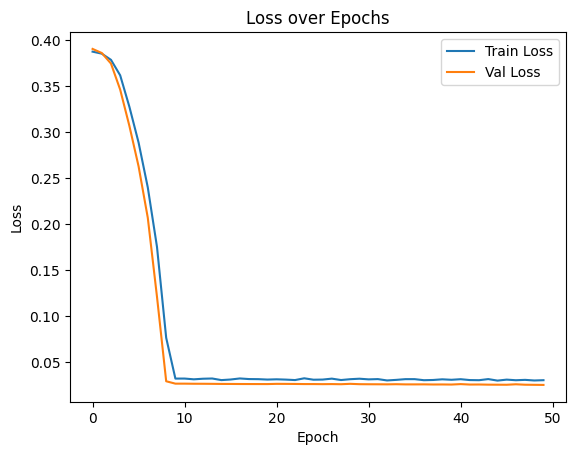


 ###### FULL DATA SET VISUALISATIONS #######


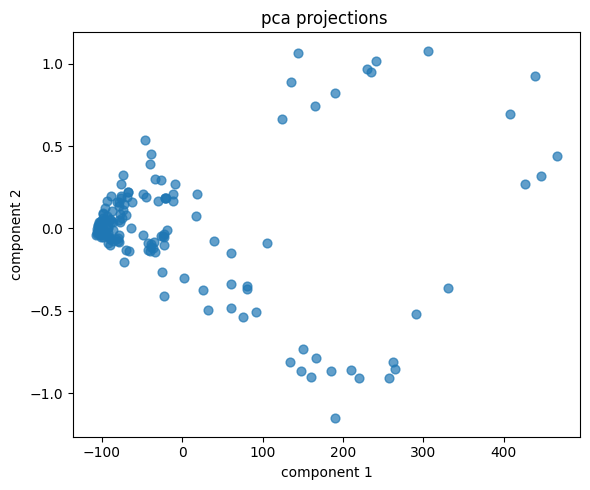

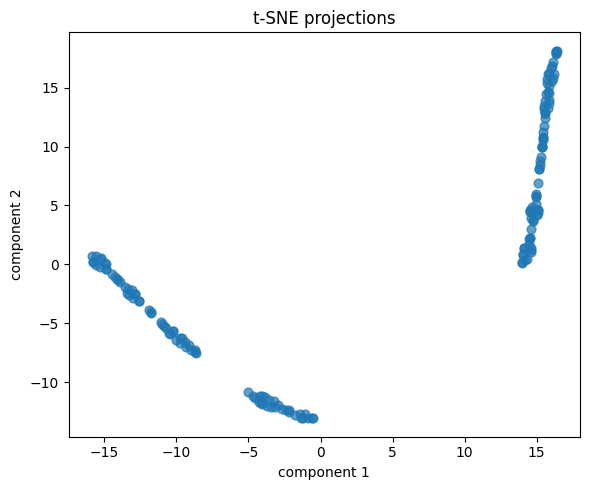

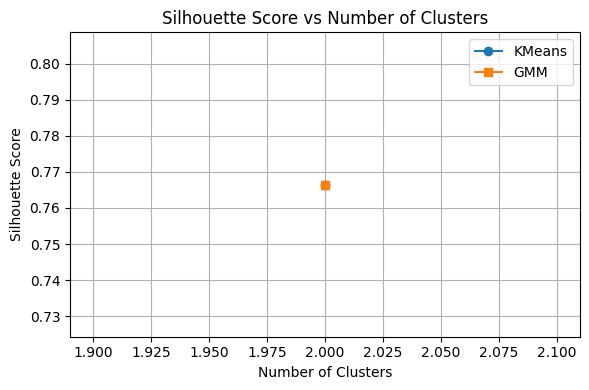

Best KMeans Score: 0.7664826 at k = 2
Best GMM Score   : 0.7664826 at k = 2
HDBSCAN Score    : 0.6509069


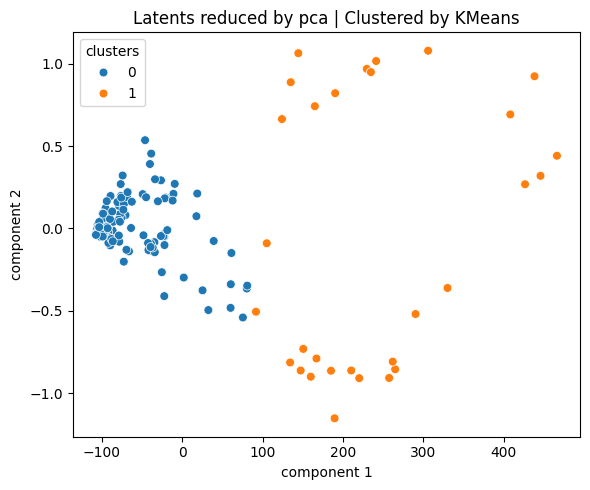

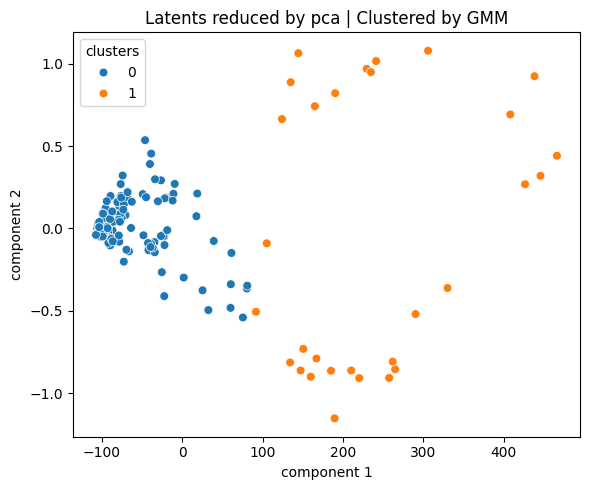

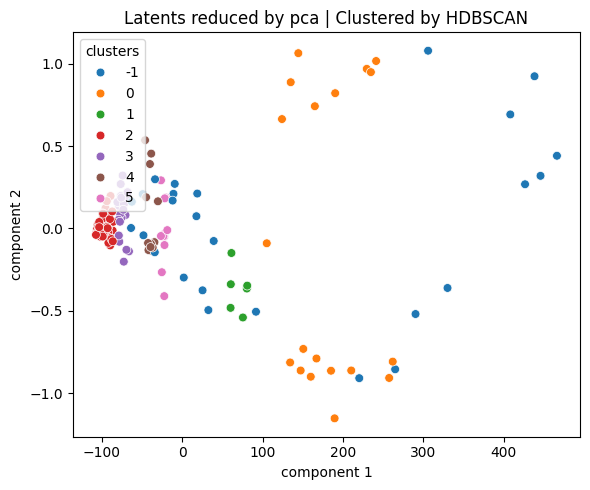

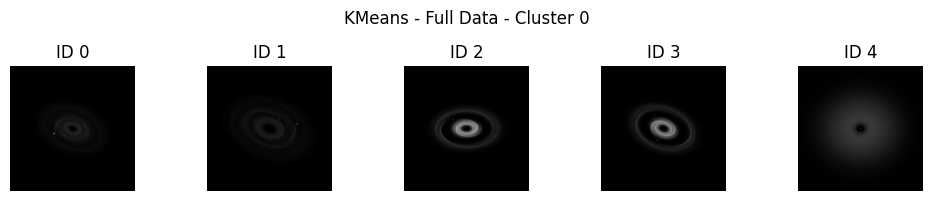

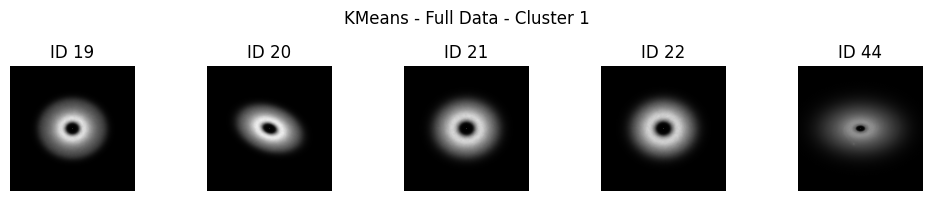

...

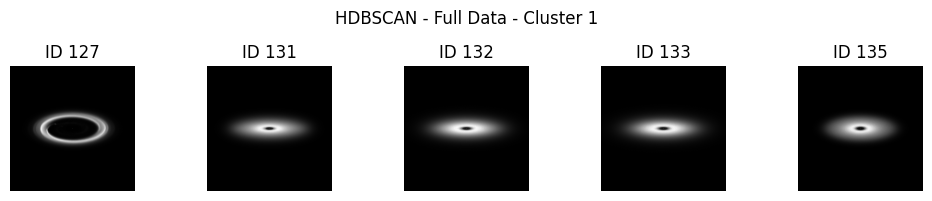

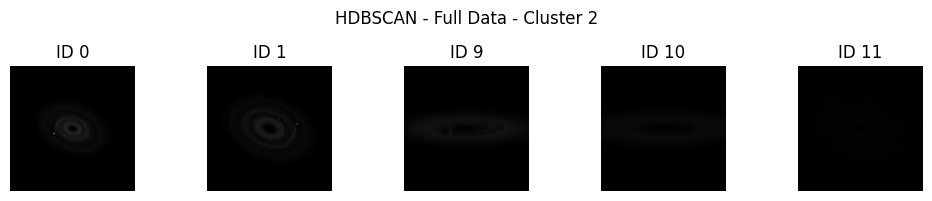

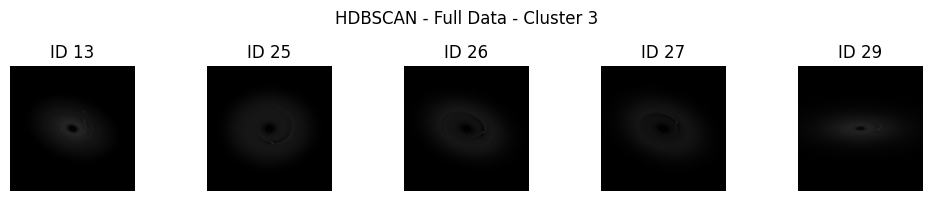

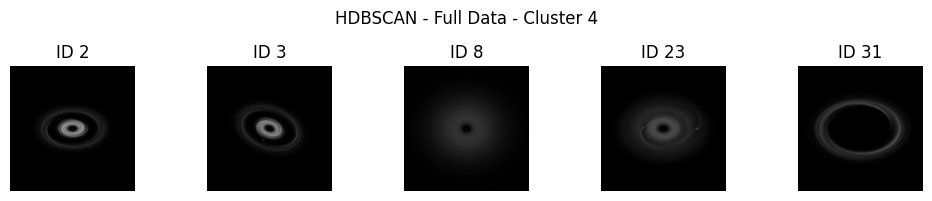

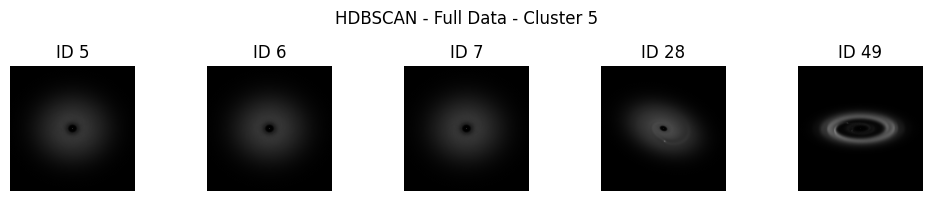

 ----------------------------END OF PIPELINE------------------------------


In [30]:
# ------------------------
# ------------------------

full_pipeline(normalised,selected_channels=[0,1],model_choice='convauto',latent_dim=256,num_epochs=50,lr=1e-4,to_viz=['full'])



**Observations** :

Based on the results of clustering we got,

**Cluster 0** shows multiple, well-defined concentric rings and gaps .
It also shows asymmetric, inclined, and elliptical-like shape which indicate inclined disks or those with eccentric planetary orbits.

* Multiple forming planets causing gaps.

* Inclined or eccentric disks.

* Asymmetric scattering or shadows.

**Cluster 1** shows featureless or smooth disks, symmetric brightness around central cavity. Appearance is more homogeneous.
Central clearing  could be caused by inner disk winds or planetary clearing

* Single-ringed or featureless appearance.

* Uniform disk evolution or efficient dust settling.

* Lower inclination.

**Future scope :**

There is still some misclassifications even from the best model.

Maybe we can try handcrafted features , defining certain properties and clustering accordingly.

Also that a state of the art model can be finetuned and checked

Try with Transformer architecture and experiment the results